In [1]:
import logging
import os
import re
from typing import Optional, List

import scanpy as sc 
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import pytorch_lightning as pl
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as TF
import wandb
from torch.utils.data import DataLoader, Dataset, SubsetRandomSampler, BatchSampler
from torchvision.transforms import ColorJitter, Normalize, RandomHorizontalFlip, RandomVerticalFlip, RandomAdjustSharpness
from timm import create_model
from einops import rearrange, reduce
from skimage.color import label2rgb
from skimage.measure import regionprops_table


note that you need to make bug fix to diffusers v0.3.0

in ~/.local/lib/python3.9/site-packages/diffusers/models/unet_blocks.py you need to change out_channels parameter in DownEncoderBlock2D to make the unet work for >2 downsamples

out_channels=in_channels if add_downsample else out_channels,


In [2]:
wandb.login()

wandb: Currently logged in as: estorrs (tme-st). Use `wandb login --relogin` to force relogin


True

#### load datasets

In [3]:
cell_type_mapping = {
    'Epithelial': ['KRT18', 'EPCAM'],
    'T cell': ['IL7R'],
    'B cell': ['MS4A1'],
    'Macrophage': ['CD14', 'FCGR3A'],
    'DC': ['HLA-DRA', 'ITGAX'],
    'Fibroblast': ['BGN'],
    'Endothelial': ['PECAM1'],
    'Acinar': ['PRSS1'],
    'Islet': ['INS']
}

genes = sorted([v for vs in cell_type_mapping.values() for v in vs])

In [4]:
# a = sc.read_h5ad('../data/pdac/HT270P1-S1H1U1/adata.h5ad')
# genes += a[:, a.var['highly_variable']].var.index.to_list()
# genes = sorted(set(genes))
len(genes)

12

In [5]:
fps = [os.path.join('../data/pdac', x) for x in os.listdir('../data/pdac')]
fps

['../data/pdac/HT270P1-S1H1U1',
 '../data/pdac/HT264P1-S1H2U1',
 '../data/pdac/HT424P1-H3A1U1',
 '../data/pdac/HT434P1-S1H3U1',
 '../data/pdac/HT427P1-S1H1U1',
 '../data/pdac/HT416P1-S1H1A1U1']

In [6]:
train_samples = [
    'HT270P1-S1H1U1',
    'HT424P1-H3A1U1',
# #     'HT434P1-S1H3U1',
    'HT427P1-S1H1U1',
]

val_samples = [
    'HT264P1-S1H2U1',
    'HT416P1-S1H1A1U1',
]

In [7]:
# def scale_expression_counts(a, scale=100.):
#     X = a.X.toarray()
# #     X = np.log1p(X.toarray())
# #      0-1
# #     X -= np.expand_dims(X.min(axis=0), 0)
# #     X /= np.expand_dims(X.max(axis=0), 0)
# #     X *= scale
# #     X = X.astype(np.int32).astype(np.float32)
#     a.X = X.astype(np.int32)
    
#     return a

In [8]:
sample_to_adata = {}

for fp in fps:
    s = fp.split('/')[-1]
    if s in train_samples or s in val_samples:
        a = sc.read_h5ad(os.path.join(fp, 'adata.h5ad'))
        a.X = a.layers['counts'].toarray().astype(np.int32) # using raw counts
        a = a[:, genes]
#         a = scale_expression_counts(a)
        sample_to_adata[s] = a

        print(s, a.shape)

HT270P1-S1H1U1 (3940, 12)
HT264P1-S1H2U1 (3234, 12)
HT424P1-H3A1U1 (2128, 12)
HT427P1-S1H1U1 (2005, 12)
HT416P1-S1H1A1U1 (2487, 12)


In [9]:
sample_to_train_adata = {k:v for k, v in sample_to_adata.items() if k in train_samples}
sample_to_val_adata = {k:v for k, v in sample_to_adata.items() if k in val_samples}

In [10]:
a = next(iter(sample_to_train_adata.values()))
a

View of AnnData object with n_obs × n_vars = 3940 × 12
    obs: 'in_tissue', 'array_row', 'array_col', 'clusters', 'spot_index'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'full_res_he', 'hvg', 'leiden', 'log1p', 'neighbors', 'nuclei_segmentation_1X_notrim', 'nuclei_segmentation_1X_trimmed', 'pca', 'rescaled_he', 'rescaled_spot_masks', 'rescaled_spot_metadata', 'segmented_nuclei_coords', 'segmented_nuclei_coords_1X_notrim', 'segmented_nuclei_coords_1X_trimmed', 'spatial', 'trimmed', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_16X_notrim', 'spatial_16X_trimmed', 'spatial_1X_notrim', 'spatial_1X_trimmed', 'spatial_2X_notrim', 'spatial_2X_trimmed', 'spatial_4X_notrim', 'spatial_4X_trimmed', 'spatial_8X_notrim', 'spatial_8X_trimmed', 'spatial_trimmed'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [11]:
a.obs

,in_tissue,array_row,array_col,clusters,spot_index
AAACAACGAATAGTTC-1,1,0,16,17,1
AAACAAGTATCTCCCA-1,1,50,102,3,2
AAACAATCTACTAGCA-1,1,3,43,2,3
AAACACCAATAACTGC-1,1,59,19,5,4
AAACAGAGCGACTCCT-1,1,14,94,14,5
...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1,1,31,77,17,3936
TTGTTTCACATCCAGG-1,1,58,42,5,3937
TTGTTTCATTAGTCTA-1,1,60,30,5,3938
TTGTTTCCATACAACT-1,1,45,27,1,3939


In [10]:
class HETransform(object):
    def __init__(self, p=.8, brightness=.1, contrast=.1, saturation=.1, hue=.1, sharpness=.3, normalize=True):
        self.brightness = brightness
        self.contrast = contrast
        self.saturation = saturation
        self.hue = hue
        self.sharpness = sharpness
        
        if normalize:
            self.normalize = Normalize((0.771, 0.651, 0.752), (0.229, 0.288, 0.224)) # from HT397B1-H2 ffpe H&E image
        else:
            self.normalize = nn.Identity()
 
        self.p = p
    
    def apply_color_transforms(self, x, brightness, contrast, saturation, hue, sharpness):
        x = TF.adjust_brightness(x, brightness)
        x = TF.adjust_contrast(x, contrast)
        x = TF.adjust_saturation(x, saturation)
        x = TF.adjust_hue(x, hue)
        x = TF.adjust_sharpness(x, sharpness)
        return x
        
    def __call__(self, he, mask, crop_rotation=None):
        """
        """
        if isinstance(he, torch.Tensor):
            hes = [he]
            masks = [mask]
            return_type = 'image'
        elif isinstance(he, dict):
            keys = list(he.keys())
            hes = [he[k] for k in keys]
            masks = [mask[k] for k in keys]
            return_type = 'dict'
        else:
            hes = he
            masks = mask
            return_type = 'list'
            
        squeeze = False
        if len(masks[0].shape) <= 2:
            masks = [x.unsqueeze(0) for x in masks]
            squeeze = True
                                
        # we apply transforms with probability p
        if torch.rand(size=(1,)) < self.p:
            deg = torch.randint(0, 360, (1,)).item()
            hes = [TF.rotate(x, deg) for x in hes]
            masks = [TF.rotate(x, deg) for x in masks]
            
            if crop_rotation is not None:
                hes = [TF.center_crop(x, crop_rotation) for x in hes]
                masks = [TF.center_crop(x, crop_rotation) for x in masks]
            
            brightness, contrast, saturation, hue, sharpness = (
                np.random.uniform(max(0, 1 - self.brightness), 1 + self.brightness, size=1)[0],
                np.random.uniform(max(0, 1 - self.contrast), 1 + self.contrast, size=1)[0],
                np.random.uniform(max(0, 1 - self.saturation), 1 + self.saturation, size=1)[0],
                np.random.uniform(-self.hue, self.hue, size=1)[0],
                np.random.uniform(max(0, 1 - self.sharpness), 1 + self.sharpness, size=1)[0],
            )
            # apply color jitter and sharpness
            hes = [self.apply_color_transforms(x, brightness, contrast, saturation, hue, sharpness)
                   for x in hes]
        else:
            if crop_rotation is not None:
                hes = [TF.center_crop(x, crop_rotation) for x in hes]
                masks = [TF.center_crop(x, crop_rotation) for x in masks]

        if squeeze:
            masks = [x.squeeze(0) for x in masks]
        
        # normalize he
        hes = [self.normalize(x) for x in hes]
                    
        if return_type == 'image':
            return hes[0], masks[0]
        elif return_type == 'dict':
            return {k:v for k, v in zip(keys, hes)}, {k:v for k, v in zip(keys, masks)}
        return hes, masks

In [11]:
def reflection_mosiac(x, border=256, dtype=torch.int32):
    max_r, max_c = x.shape[-2], x.shape[-1]
    if len(x.shape) == 3:
        mosaic = torch.zeros((x.shape[0], max_r + (border * 2), max_c + (border * 2))).to(dtype)
    else:
        mosaic = torch.zeros((max_r + (border * 2), max_c + (border * 2))).to(dtype)
    # make tiles
    top_left = TF.pad(x, padding=[border, border, 0, 0], padding_mode='reflect')
    top_right = TF.pad(x, padding=[0, border, border, 0], padding_mode='reflect')
    bottom_left = TF.pad(x, padding=[border, 0, 0, border], padding_mode='reflect')
    bottom_right = TF.pad(x, padding=[0, 0, border, border], padding_mode='reflect')
    
    if len(x.shape) == 3:
        mosaic[:, :max_r + border, :max_c + border] = top_left
        mosaic[:, :max_r + border, border:] = top_right
        mosaic[:, border:, :max_c + border] = bottom_left
        mosaic[:, border:, border:] = bottom_right
    else:
        mosaic[:max_r + border, :max_c + border] = top_left
        mosaic[:max_r + border, border:] = top_right
        mosaic[border:, :max_c + border] = bottom_left
        mosaic[border:, border:] = bottom_right
    
    return mosaic

In [12]:
def get_img_dicts(adata, keys=('2X', '8X'), border=256, mode='spot'):
    he_dict = {}
    for k, x in adata.uns['rescaled_he'].items():
        if re.findall(r'^[0-9]+X.*$', k) and 'trimmed' in k:
            scale = int(re.sub(r'^([0-9]+)X.*$', r'\1', k))
            x = torch.tensor(rearrange(x, 'h w c -> c h w')).to(torch.uint8)
            x = reflection_mosiac(x, border=border, dtype=torch.uint8)
            x = rearrange(x, 'c h w -> h w c').numpy().astype(np.uint8)
            he_dict[f'{scale}X'] = x
            
    mask_dict = {}
    for k, x in adata.uns['rescaled_spot_masks'].items():
        if re.findall(r'^[0-9]+X.*$', k) and 'trimmed' in k:
            scale = int(re.sub(r'^([0-9]+)X.*$', r'\1', k))
            x = torch.tensor(x.astype(np.int32))
            x = reflection_mosiac(x, border=border, dtype=torch.int32)
            x = x.numpy().astype(np.int32)
            mask_dict[f'{scale}X'] = x
            
    if mode == 'hex':
        mask_dict = {k:convert_spot_masks(adata, mask=v, key=f'{k}_trimmed', mode='hex')
                     for k, v in mask_dict.items()}
            
    he_dict = {k:v for k, v in he_dict.items() if k in keys}
    mask_dict = {k:v for k, v in mask_dict.items() if k in keys}
    
    return he_dict, mask_dict

In [13]:
def convert_rgb(img):
    if img.shape[-1] == 3:
        img = rearrange(img, 'h w c -> c h w')
        
    if not isinstance(img, torch.Tensor):
        img = torch.tensor(img)
        
    if img.dtype == torch.uint8:
        img = TF.convert_image_dtype(img, dtype=torch.float32)
    
    if img.max() > 1.:
        img -= img.min()
        img /= img.max()
    
    return img


def create_masks(labeled_mask, max_area, thresh=.5):
    voxel_idxs = torch.unique(labeled_mask)[1:].to(torch.long)
    masks = torch.zeros((len(voxel_idxs), labeled_mask.shape[0], labeled_mask.shape[1]), dtype=torch.bool)
    for i, l in enumerate(voxel_idxs):
        m = masks[i]
        m[labeled_mask==l] = 1
    
    keep = masks.sum(dim=(-1,-2)) / max_area > thresh
    
    if keep.sum() > 0:
        masks = masks[keep]
        voxel_idxs = voxel_idxs[keep]    
        return masks, voxel_idxs
    
    return None, None
        

class STDataset(Dataset):
    """ST Dataset"""
    def __init__(self, adata, he, he_context, labeled_mask, context_scaler, coordinate_key,
                 tile_size=512, rotation_scaler=2, he_transform=None,
                 border=512, max_jitter=0., min_voxel_fraction=.5, normalize=True):
        self.spot_ids, _ = zip(*sorted([(sid, sidx) for sid, sidx in zip(adata.obs.index, adata.obs['spot_index'])],
                                    key=lambda x: x[1]))
        self.spot_ids = np.asarray(self.spot_ids)
        self.rotation_scaler = rotation_scaler
        self.adata = adata[self.spot_ids]
        self.context_scaler = context_scaler
        self.he = convert_rgb(he)
        self.he_context = convert_rgb(he_context)
        self.labeled_mask = torch.tensor(labeled_mask, dtype=torch.int32) if not isinstance(labeled_mask, torch.Tensor) else labeled_mask
        
        self.he_transform = he_transform
            
        if normalize:
            self.normalize = Normalize((0.771, 0.651, 0.752), (0.229, 0.288, 0.224)) # from HT397B1-H2 ffpe H&E image
        else:
            self.normalize = nn.Identity()
                
        self.exp = torch.tensor(adata.X, dtype=torch.int32)

        self.tile_size = tile_size 
        
        self.offset = int(self.tile_size * self.rotation_scaler // 2 + 1)
        self.border = border
        self.max_jitter = max_jitter
  
        self.pixel_coords = np.asarray([[int(r), int(c)] for c, r in self.adata.obsm[coordinate_key]])
    
        idxs = np.random.choice(np.arange(self.pixel_coords.shape[0]), size=200)
        max_spots = 0
        for i in idxs:
#             if i % 10 == 0:
#                 print(i)
            r, c = self.pixel_coords[i]
            r, c = r + self.border, c + self.border # adjust for reflection padding
            r, c = r - self.offset, c - self.offset # adjust from center to top left
            lm = TF.crop(
                self.labeled_mask, top=r, left=c,
                height=self.tile_size, width=self.tile_size)
            m, _ = create_masks(lm, 1000, thresh=.0001)
            
            if m is not None:
                m = m[m.sum(dim=(-1, -2))>0]
                max_spots = max(max_spots, m.shape[0])
    
        self.max_spots = 2**int(np.log2(max_spots + 1) + 1)
        
        r, c = self.he.shape[1] // 2, self.he.shape[2] // 2
        tile = TF.crop(self.labeled_mask, top=r, left=c, height=self.tile_size, width=self.tile_size)
        self.max_voxel_area = np.max(
            regionprops_table(tile.detach().numpy(), properties=['label', 'area'])['area'])
        self.min_voxel_fraction = min_voxel_fraction
        
    def __len__(self):
        return len(self.pixel_coords)
    
    def __getitem__(self, idx):
        r, c = self.pixel_coords[idx]
        r = int(r + np.random.uniform(-self.max_jitter, self.max_jitter))
        c = int(c + np.random.uniform(-self.max_jitter, self.max_jitter))
        r_context, c_context = r // self.context_scaler, c // self.context_scaler
        
        # add offset and border
        r, c = r + self.border - self.offset, c + self.border - self.offset
        r_context, c_context = r_context + self.border - self.offset, c_context + self.border - self.offset
            
        he = TF.crop(
            self.he, top=r, left=c,
            height=self.tile_size * self.rotation_scaler, width=self.tile_size * self.rotation_scaler)
        he_context = TF.crop(
            self.he_context, top=r_context, left=c_context,
            height=self.tile_size * self.rotation_scaler, width=self.tile_size * self.rotation_scaler)
        
        # create mask
        lm = TF.crop(
            self.labeled_mask, top=r, left=c,
            height=self.tile_size * self.rotation_scaler, width=self.tile_size * self.rotation_scaler)
        
        if self.he_transform is not None:
            (he, he_context), (lm,) = self.he_transform(
                [he, he_context], [lm], crop_rotation=(self.tile_size, self.tile_size))
        
        m, v_idxs = create_masks(lm, self.max_voxel_area, thresh=self.min_voxel_fraction)
        
        masks = torch.zeros((self.max_spots, he.shape[1], he.shape[2]), dtype=torch.bool)
        voxel_idxs = torch.zeros((self.max_spots,), dtype=torch.int32)
        exp = torch.zeros((self.max_spots, self.exp.shape[1]), dtype=self.exp.dtype)
        if m is not None:
            idxs = v_idxs - 1
#             print(masks.shape, m.shape)
            masks[:len(idxs)] = m
            voxel_idxs[:len(idxs)] = v_idxs
            exp = torch.zeros((self.max_spots, self.exp.shape[1]), dtype=torch.float32)
            exp[:len(idxs)] = self.exp[idxs].to(torch.float32)
            exp *= (masks.sum(dim=(1,2)).unsqueeze(dim=-1) + 1.) / self.max_voxel_area
            exp = torch.round(exp).to(self.exp.dtype)
        
        
        return {
            'he': self.normalize(he),
            'he_context': self.normalize(he_context),
            'he_orig': he,
            'masks': masks,
            'voxel_idxs': voxel_idxs,
            'exp': exp,
            'n_voxels': len(idxs) if torch.sum(voxel_idxs) > 0 else 0
        }
        
        

In [16]:
scales = [2, 8]
keys = [f'{s}X' for s in scales]
mode = 'spot'  
tile_size = 256 
spot_radius = next(iter(sample_to_adata.values())).uns['rescaled_spot_metadata'][keys[0] + '_trimmed']['spot_radius']
jitter = int(spot_radius * 4)
border = jitter * 4

train_he_transform = HETransform(p=.95, brightness=.1, contrast=.1, saturation=.1, hue=.1, normalize=False)
sample_to_train_ds = {}
for s in train_samples:
    print(s)
    a = sample_to_adata[s]

    he_dict, mask_dict = get_img_dicts(a, keys=keys, border=border, mode=mode)

    ds = STDataset(
        a, he_dict[keys[0]], he_dict[keys[1]], mask_dict[keys[0]], scales[1] // scales[0], 'spatial_2X_trimmed',
        tile_size=tile_size, he_transform=train_he_transform,
        max_jitter=jitter, border=border, min_voxel_fraction=.25, normalize=True)
    
    sample_to_train_ds[s] = ds
    

HT270P1-S1H1U1


In [17]:
val_he_transform = HETransform(p=0., normalize=False)

sample_to_val_ds = {}
for s in val_samples:
    print(s)
    a = sample_to_adata[s]

    he_dict, mask_dict = get_img_dicts(a, keys=keys, border=border, mode=mode)

    ds = STDataset(
        a, he_dict[keys[0]], he_dict[keys[1]], mask_dict[keys[0]], scales[1] // scales[0], 'spatial_2X_trimmed',
        tile_size=tile_size, he_transform=val_he_transform,
        max_jitter=0., border=border, min_voxel_fraction=.25, normalize=True)
    
    sample_to_val_ds[s] = ds
    

HT264P1-S1H2U1


In [14]:
class MultisampleSTDataset(Dataset):
    def __init__(self, ds_dict):
        super().__init__()
        self.samples = list(ds_dict.keys())
        self.ds_dict = ds_dict
        
        self.mapping = [(k, i) for k, ds in ds_dict.items() for i in range(len(ds))]
        
    def __len__(self):
        return len(self.mapping)

    def __getitem__(self, idx):
        k, i = self.mapping[idx]
        
        d = self.ds_dict[k][i]

        return d

In [19]:
train_ds = MultisampleSTDataset(sample_to_train_ds)
len(train_ds)

3940

In [20]:
val_ds = MultisampleSTDataset(sample_to_val_ds)
len(val_ds)

3234

In [10]:
batch_size = 32

In [22]:
train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, pin_memory=True, num_workers=10)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=False)

In [23]:
%%time
batch = next(iter(train_dl))

CPU times: user 2.53 s, sys: 1.45 s, total: 3.97 s
Wall time: 10 s


###### data inspection

In [23]:
def cte(padded_exp, masks, n_voxels):
    tile = torch.zeros((masks.shape[1], masks.shape[2], padded_exp.shape[1]))
    for exp, m in list(zip(padded_exp, masks))[:n_voxels]:
        tile[m==1] = exp.to(torch.float32)
    return tile

0


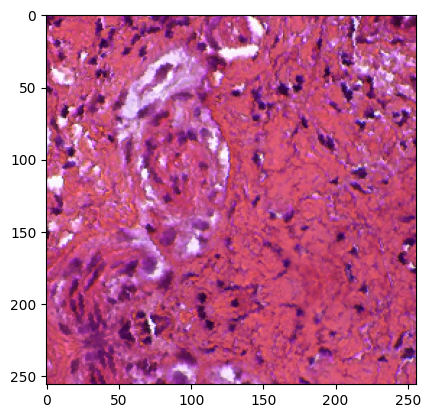

1


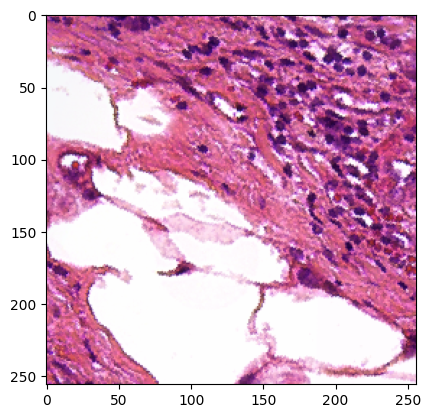

2


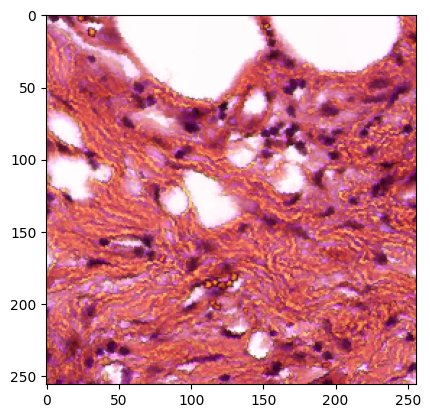

3


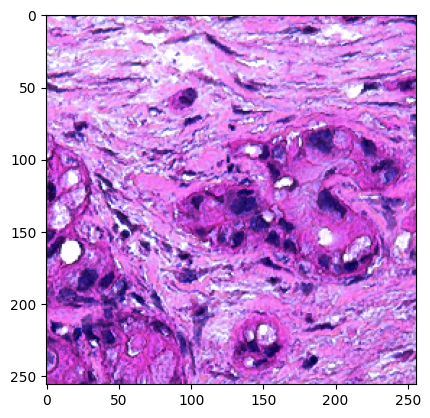

4


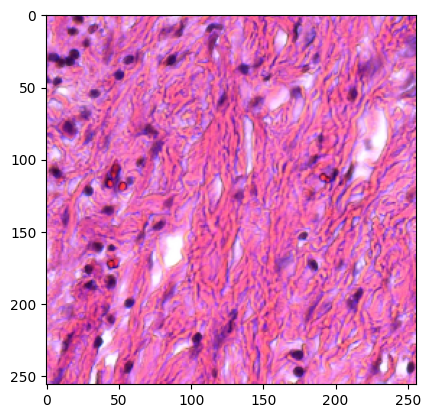

5


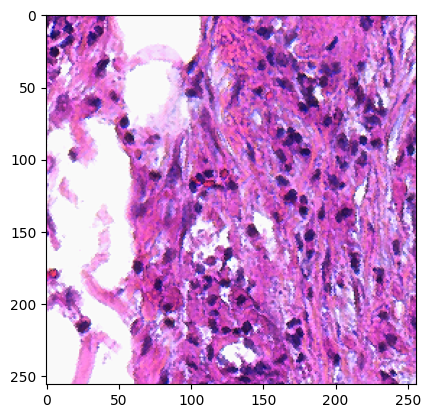

6


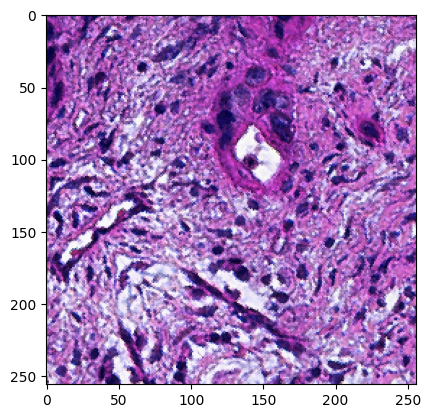

7


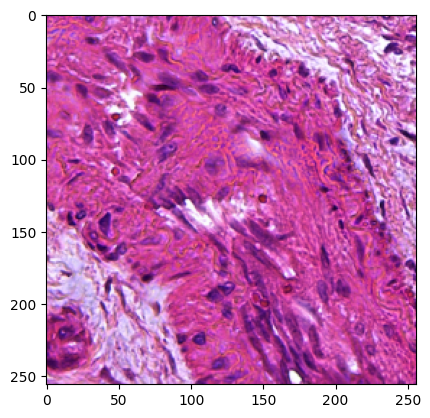

8


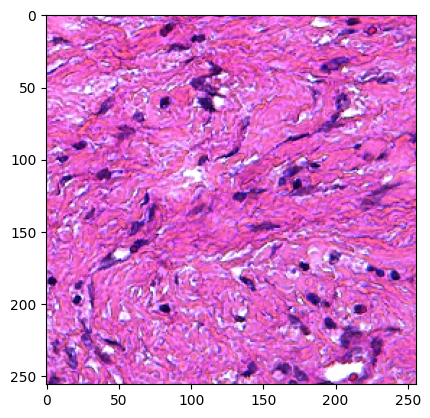

9


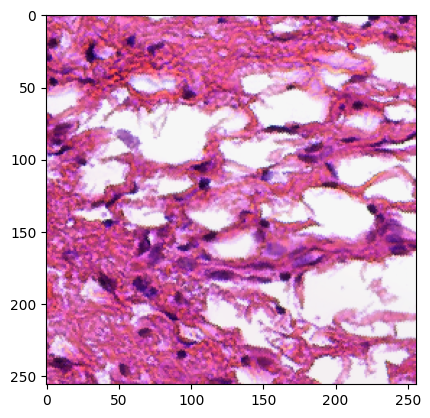

10


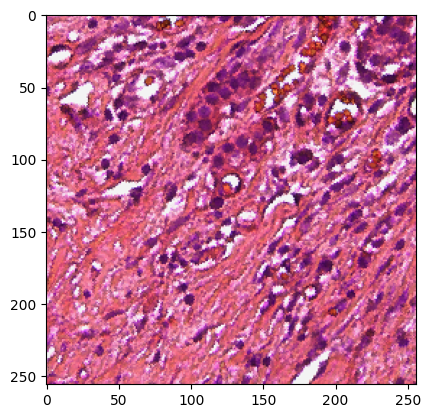

11


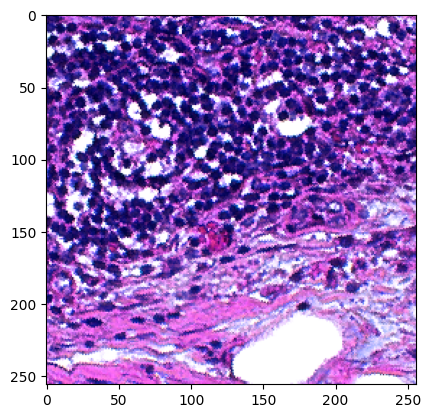

12


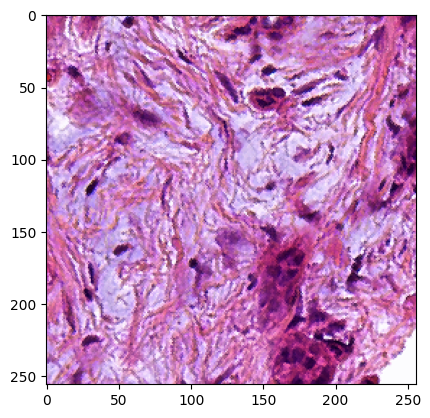

13


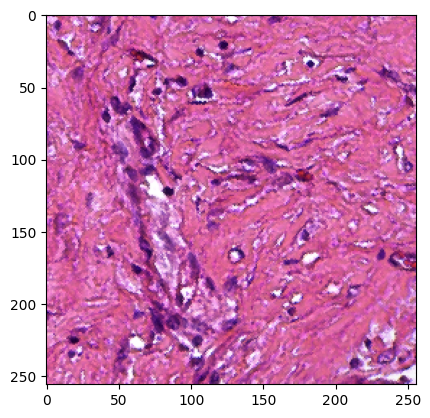

14


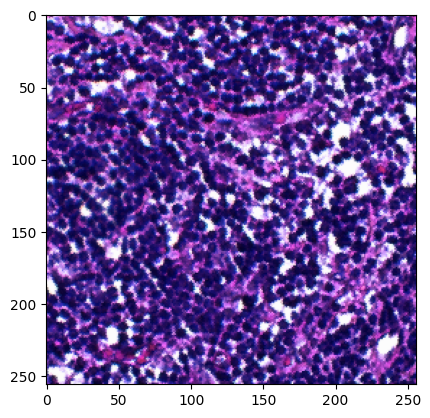

15


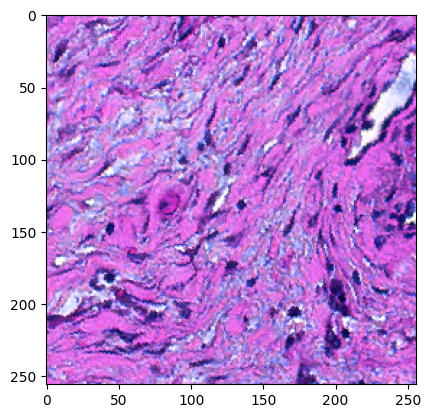

16


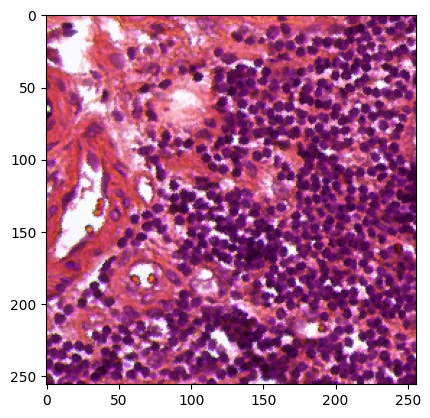

17


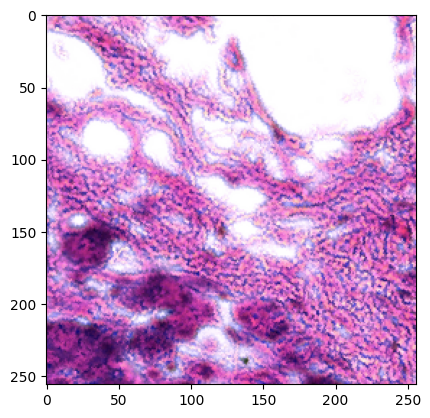

18


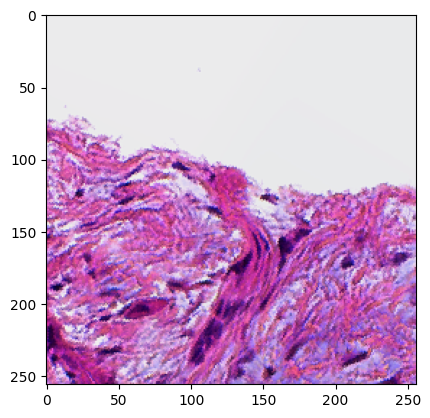

19


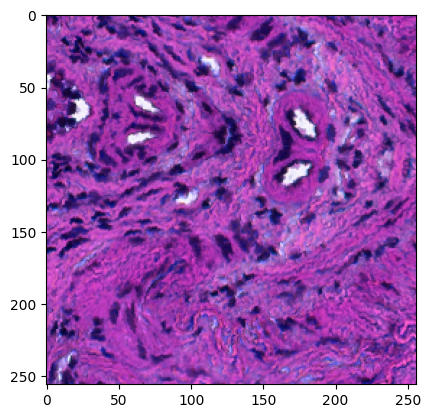

20


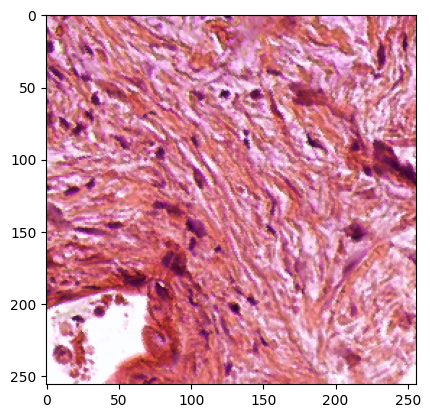

21


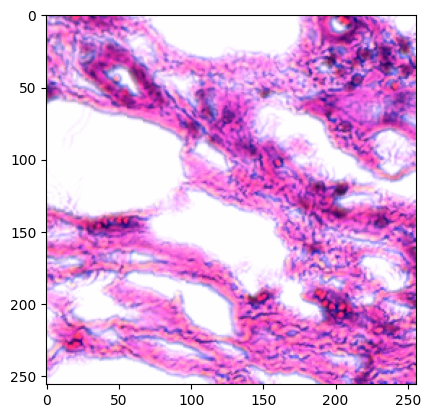

22


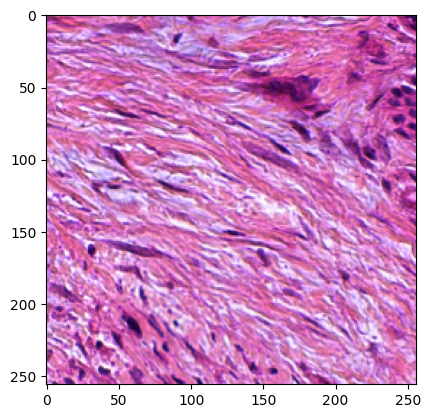

23


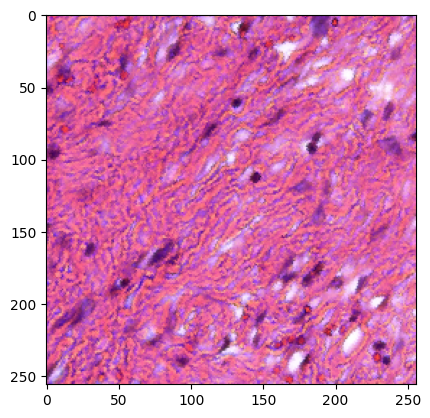

24


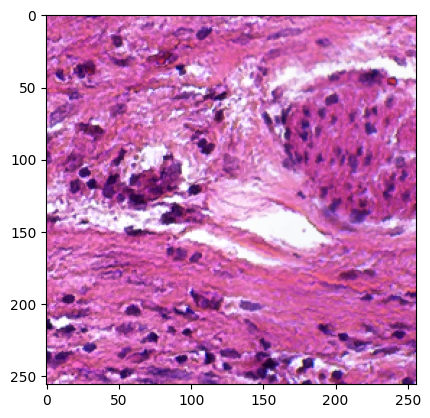

In [24]:
for i in range(25):
    print(i)
    img = rearrange(train_ds[i]['he_orig'], 'c h w -> h w c')
    img -= img.min()
    img /= img.max()
    plt.imshow(img)
    plt.show()

In [28]:
# i = 166
# i = 66
# i = 22
i = 14
d = train_ds[i]

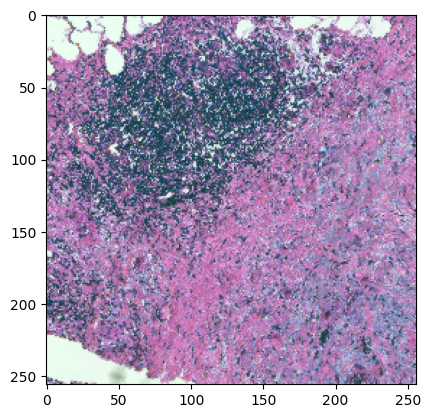

In [29]:
img = rearrange(d['he_context'], 'c h w -> h w c')
img -= img.min()
img /= img.max()
plt.imshow(img)

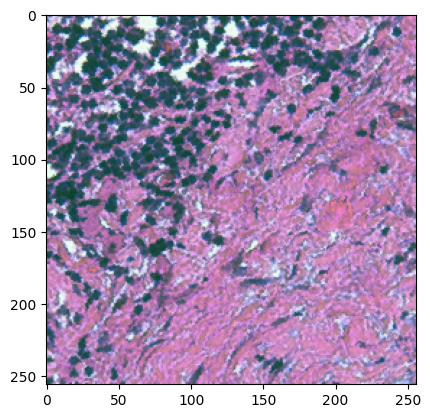

In [30]:
img = rearrange(d['he'], 'c h w -> h w c')
img -= img.min()
img /= img.max()
plt.imshow(img)

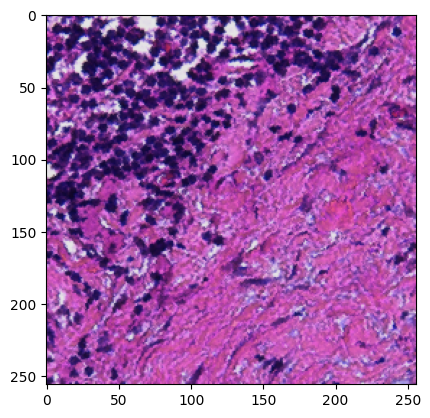

In [31]:
img = rearrange(d['he_orig'], 'c h w -> h w c')
plt.imshow(img)

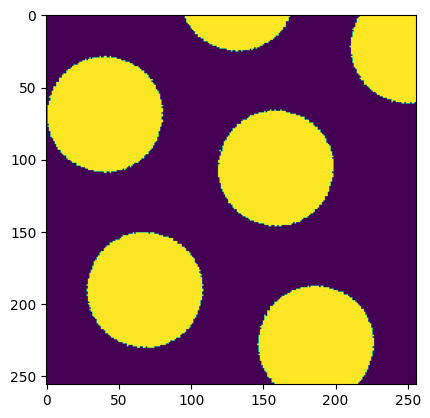

In [32]:
plt.imshow(torch.sum(d['masks'], dim=0))

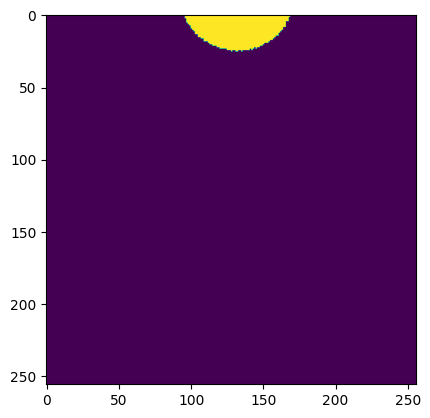

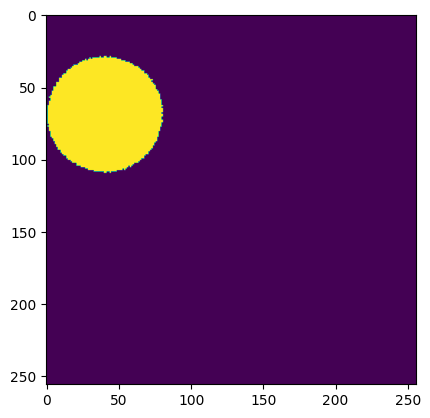

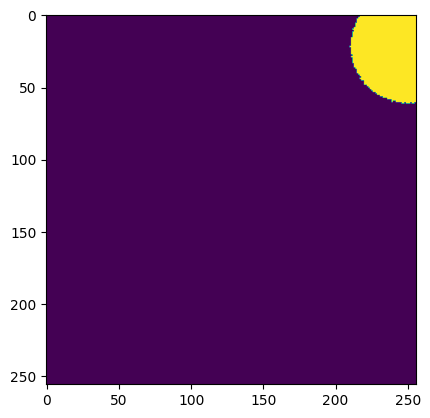

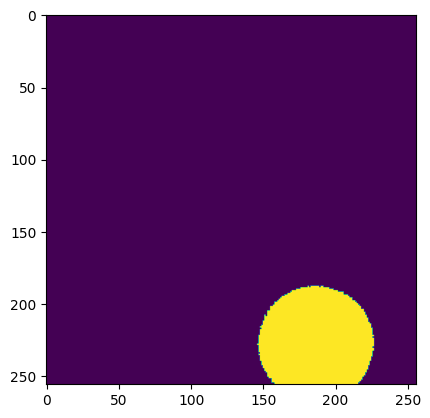

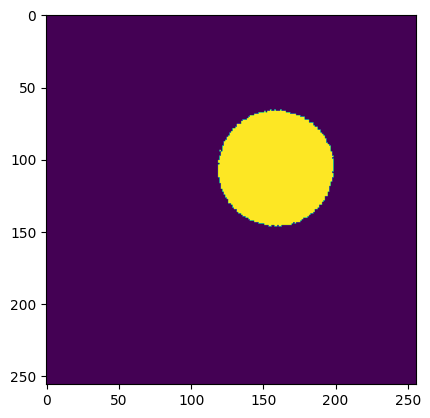

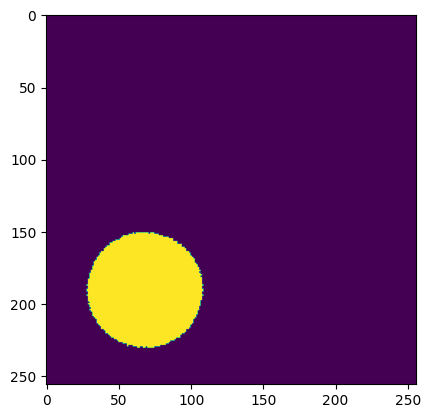

In [33]:
for j in range(d['n_voxels']):
    plt.imshow(d['masks'][j])
    plt.show()

In [34]:
d['masks'].shape

torch.Size([16, 256, 256])

In [35]:
torch.sum(d['masks'], dim=(-1, -2))

tensor([1382, 5019, 2397, 4547, 5021, 5023,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0])

In [36]:
a.var.index.to_list().index('KRT18')

959

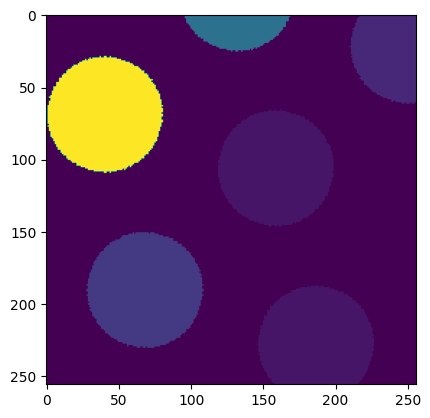

In [37]:
gene = 'IL7R'
recon = cte(d['exp'], d['masks'], d['n_voxels'])
plt.imshow(recon[:, :, a.var.index.to_list().index(gene)])

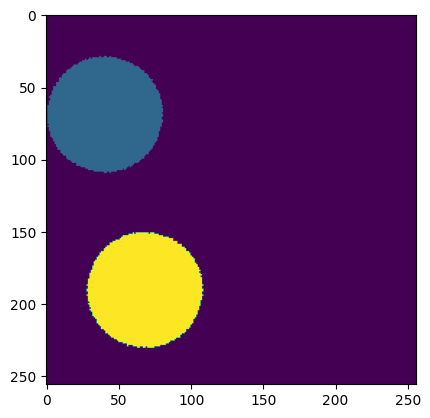

In [38]:
gene = 'KRT18'
recon = cte(d['exp'], d['masks'], d['n_voxels'])
plt.imshow(recon[:, :, a.var.index.to_list().index(gene)])

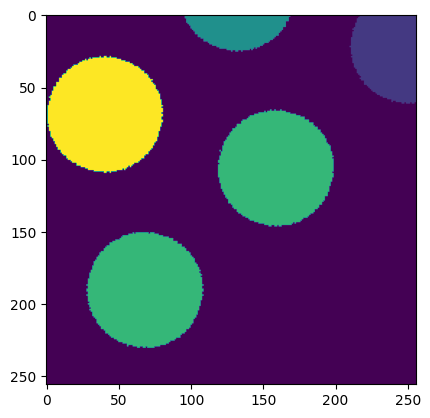

In [39]:
gene = 'PECAM1'
recon = cte(d['exp'], d['masks'], d['n_voxels'])
plt.imshow(recon[:, :, a.var.index.to_list().index(gene)])

In [40]:
d['exp']

tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]], dtype=torch.int32)

In [41]:
d['voxel_idxs']

tensor([  15,  357, 1384, 1853, 2230, 3127,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0], dtype=torch.int32)

In [42]:
a = next(iter(sample_to_train_adata.values()))
a

View of AnnData object with n_obs × n_vars = 3940 × 2002
    obs: 'in_tissue', 'array_row', 'array_col', 'clusters', 'spot_index'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'full_res_he', 'hvg', 'leiden', 'log1p', 'neighbors', 'nuclei_segmentation_1X_notrim', 'nuclei_segmentation_1X_trimmed', 'pca', 'rescaled_he', 'rescaled_spot_masks', 'rescaled_spot_metadata', 'segmented_nuclei_coords', 'segmented_nuclei_coords_1X_notrim', 'segmented_nuclei_coords_1X_trimmed', 'spatial', 'trimmed', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_16X_notrim', 'spatial_16X_trimmed', 'spatial_1X_notrim', 'spatial_1X_trimmed', 'spatial_2X_notrim', 'spatial_2X_trimmed', 'spatial_4X_notrim', 'spatial_4X_trimmed', 'spatial_8X_notrim', 'spatial_8X_trimmed', 'spatial_trimmed'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

/tmp/402863.tmpdir/ipykernel_14699/312135849.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  a.obs['highlight'] = ['yes' if i in pool else 'no'
/miniconda/lib/python3.9/contextlib.py:126: FutureWarning: X.dtype being converted to np.float32 from int32. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


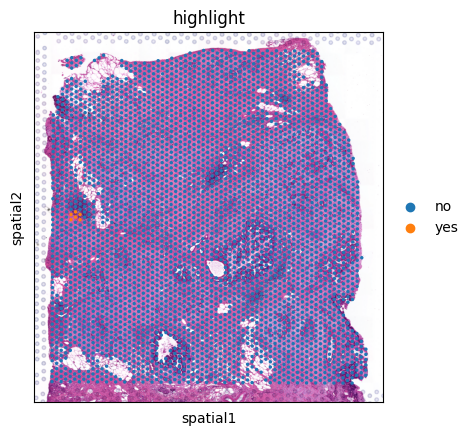

In [43]:
pool = set(d['voxel_idxs'][:d['n_voxels']].detach().numpy())
a.obs['highlight'] = ['yes' if i in pool else 'no'
                               for i in a.obs['spot_index']]
sc.pl.spatial(a, color='highlight')

In [76]:
i = 1

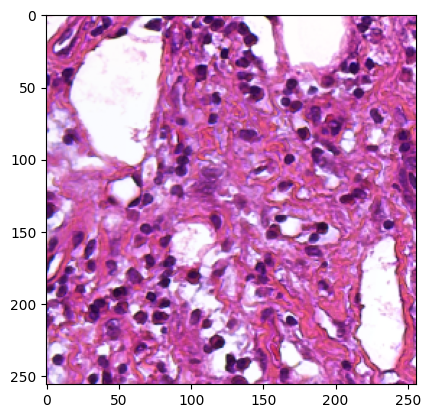

In [77]:
img = rearrange(val_ds[i]['he_orig'], 'c h w -> h w c')
plt.imshow(img)

In [78]:
gene = 'EPCAM'
recon = cte(val_ds[i]['exp'], val_ds[i]['masks'], val_ds[i]['n_voxels'])
plt.imshow(recon[:, :, val_adata.var.index.to_list().index(gene)])

NameError: name 'val_adata' is not defined

In [ ]:
pool = set(val_ds[i]['voxel_idxs'][:val_ds[i]['n_voxels']].detach().numpy())
val_adata.obs['highlight'] = ['yes' if i in pool else 'no'
                               for i in val_adata.obs['spot_index']]
sc.pl.spatial(val_adata, color='highlight')

#### model

In [11]:
"""
modified from https://gist.github.com/rwightman/f8b24f4e6f5504aba03e999e02460d31
"""
class Unet(nn.Module):
    """Unet is a fully convolution neural network for image semantic segmentation
    Args:
        encoder_name: name of classification model (without last dense layers) used as feature
            extractor to build segmentation model.
        encoder_weights: one of ``None`` (random initialization), ``imagenet`` (pre-training on ImageNet).
        decoder_channels: list of numbers of ``Conv2D`` layer filters in decoder blocks
        decoder_use_batchnorm: if ``True``, ``BatchNormalisation`` layer between ``Conv2D`` and ``Activation`` layers
            is used.
        num_classes: a number of classes for output (output shape - ``(batch, classes, h, w)``).
        center: if ``True`` add ``Conv2dReLU`` block on encoder head
    NOTE: This is based off an old version of Unet in https://github.com/qubvel/segmentation_models.pytorch
    """

    def __init__(
            self,
            backbone='resnet34',
            backbone_kwargs=None,
            backbone_indices=None,
            decoder_use_batchnorm=True,
            decoder_channels=(256, 128, 64, 32, 16),
            in_chans=1,
            num_classes=5,
            center=False,
            norm_layer=nn.BatchNorm2d,
    ):
        super().__init__()
        backbone_kwargs = backbone_kwargs or {}
        # NOTE some models need different backbone indices specified based on the alignment of features
        # and some models won't have a full enough range of feature strides to work properly.
        encoder = create_model(
            backbone, features_only=True, out_indices=backbone_indices, in_chans=in_chans,
            pretrained=False, **backbone_kwargs)
        encoder_channels = encoder.feature_info.channels()[::-1]
        self.encoder = encoder

        if not decoder_use_batchnorm:
            norm_layer = None
        self.decoder = UnetDecoder(
            encoder_channels=encoder_channels,
            decoder_channels=decoder_channels,
            final_channels=num_classes,
            norm_layer=norm_layer,
            center=center,
        )

    def forward(self, x: torch.Tensor):
        x = self.encoder(x)
        x.reverse()  # torchscript doesn't work with [::-1]
        x = self.decoder(x)
        return x


class Conv2dBnAct(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, padding=0,
                 stride=1, act_layer=nn.ReLU, norm_layer=nn.BatchNorm2d):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride=stride, padding=padding, bias=False)
        self.bn = norm_layer(out_channels)
        self.act = act_layer(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        x = self.act(x)
        return x


class DecoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, scale_factor=2.0, act_layer=nn.ReLU, norm_layer=nn.BatchNorm2d):
        super().__init__()
        conv_args = dict(kernel_size=3, padding=1, act_layer=act_layer)
        self.scale_factor = scale_factor
        if norm_layer is None:
            self.conv1 = Conv2dBnAct(in_channels, out_channels, **conv_args)
            self.conv2 = Conv2dBnAct(out_channels, out_channels,  **conv_args)
        else:
            self.conv1 = Conv2dBnAct(in_channels, out_channels, norm_layer=norm_layer, **conv_args)
            self.conv2 = Conv2dBnAct(out_channels, out_channels, norm_layer=norm_layer, **conv_args)

    def forward(self, x, skip: Optional[torch.Tensor] = None):
        if self.scale_factor != 1.0:
            x = F.interpolate(x, scale_factor=self.scale_factor, mode='nearest')
        if skip is not None:
            x = torch.cat([x, skip], dim=1)
        x = self.conv1(x)
        x = self.conv2(x)
        return x


class UnetDecoder(nn.Module):

    def __init__(
            self,
            encoder_channels,
            decoder_channels=(256, 128, 64, 32, 16),
            final_channels=1,
            norm_layer=nn.BatchNorm2d,
            center=False,
    ):
        super().__init__()

        if center:
            channels = encoder_channels[0]
            self.center = DecoderBlock(channels, channels, scale_factor=1.0, norm_layer=norm_layer)
        else:
            self.center = nn.Identity()

        in_channels = [in_chs + skip_chs for in_chs, skip_chs in zip(
            [encoder_channels[0]] + list(decoder_channels[:-1]),
            list(encoder_channels[1:]) + [0])]
        out_channels = decoder_channels

        self.blocks = nn.ModuleList()
        for in_chs, out_chs in zip(in_channels, out_channels):
            self.blocks.append(DecoderBlock(in_chs, out_chs, norm_layer=norm_layer))
        self.final_conv = nn.Conv2d(out_channels[-1], final_channels, kernel_size=(1, 1))

        self._init_weight()

    def _init_weight(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                torch.nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def forward(self, x: List[torch.Tensor]):
        encoder_head = x[0]
        skips = x[1:]
        x = self.center(encoder_head)
        for i, b in enumerate(self.blocks):
            skip = skips[i] if i < len(skips) else None
            x = b(x, skip)
        x = self.final_conv(x)
        return x

In [12]:
class UnetBased(nn.Module):
    def __init__(
        self,
        genes,
        tile_resolution = 16,
        n_metagenes = 20,
        in_channels = 3,
        out_channels = 64,
        decoder_channels = (128, 64, 32, 16, 8),
        context_decoder_channels = (128, 64, 32, 16, 8),
        he_scaler = .1,
        kl_scaler = .001,
        exp_scaler = 1.
    ):
        super().__init__()
        
        self.genes = genes
        self.n_genes = len(genes)

        
        self.he_scaler = he_scaler
        self.kl_scaler = kl_scaler
        self.exp_scaler = exp_scaler
        
        self.unet = Unet(backbone='resnet34',
                         decoder_channels=decoder_channels,
                         in_chans=in_channels,
                         num_classes=out_channels)
        
        self.context_unet = Unet(backbone='resnet34',
                         decoder_channels=context_decoder_channels,
                         in_chans=in_channels,
                         num_classes=out_channels)
        
        self.post_unet_conv = nn.Conv2d(in_channels=out_channels * 2, out_channels=out_channels,
                                        kernel_size=1)

        # latent mu and var
        self.latent_mu = nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=1)
        self.latent_var = nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=1)
        self.latent_norm = nn.BatchNorm2d(out_channels) # try changing momentum
        
        self.n_metagenes = n_metagenes
        self.tile_resolution = tile_resolution
        self.metagenes = torch.nn.Parameter(torch.rand(self.n_metagenes, self.n_genes))
        self.scale_factors = torch.nn.Parameter(torch.rand(self.n_genes))
        self.p = torch.nn.Parameter(torch.rand(self.n_genes))
        
        self.post_decode_he = torch.nn.Conv2d(out_channels, 3, 1)
        self.post_decode_exp = torch.nn.Conv2d(out_channels, self.n_metagenes, 1)
        
        self.he_loss = torch.nn.MSELoss()
        
    def _kl_divergence(self, z, mu, std):
        # lightning imp.
        # Monte carlo KL divergence
        p = torch.distributions.Normal(torch.zeros_like(mu), torch.ones_like(std))
        q = torch.distributions.Normal(mu, std)

        log_qzx = q.log_prob(z)
        log_pz = p.log_prob(z)

        kl = (log_qzx - log_pz)
        kl = kl.sum(-1)

        return kl

    def encode(self, x, x_context, use_means=False):
        x_encoded = self.unet(x)
        x_context_encoded = self.context_unet(x)
        
        x_encoded = torch.concat((x_encoded, x_context_encoded), dim=1)
        x_encoded = self.post_unet_conv(x_encoded)
        
        x_encoded = self.latent_norm(x_encoded)
        
        mu, log_var = self.latent_mu(x_encoded), self.latent_var(x_encoded)
        
        # sample z from parameterized distributions
        std = torch.exp(log_var / 2)
        q = torch.distributions.Normal(mu, std)
        # get our latent
        if use_means:
            z = mu
        else:
            z = q.rsample()

        return z, mu, std
    
    def calculate_loss(self, he_true, exp_true, result):
        exp_loss = torch.mean(-result['nb'].log_prob(exp_true))
        
        kl_loss = torch.mean(self._kl_divergence(result['z'], result['z_mu'], result['z_std']))
        
        he_loss = torch.mean(self.he_loss(he_true, result['he']))
        
        return {
            'overall_loss': exp_loss * self.exp_scaler + kl_loss * self.kl_scaler + he_loss * self.he_scaler,
            'exp_loss': exp_loss,
            'kl_loss': kl_loss,
            'he_loss': he_loss
        }
    
    def reconstruct_expression(self, dec, masks=None, voxel_idxs=None, reduce_to_voxel=True, gene_idxs=None):
        x = self.post_decode_exp(dec) # (b c h w)
        
        if reduce_to_voxel:
            x = reduce_to_voxel_level(x, masks) # (b, v, m)
        else:  
            x = rearrange(x, 'b c h w -> b h w c')
            
        if gene_idxs is not None:
            metagenes = self.metagenes[:, gene_idxs]
            scale_factors = self.scale_factors[gene_idxs]
            p = self.p[gene_idxs]
        else:
            metagenes = self.metagenes
            scale_factors = self.scale_factors
            p = self.p
        
        r = x @ metagenes
        r = r * scale_factors
        r = F.softplus(r)
        
        p = torch.sigmoid(p)
        
        if reduce_to_voxel:
            p = rearrange(p, 'c -> 1 1 c')
            r = mask_nb_params(r, voxel_idxs)
        else:
            p = rearrange(p, 'c -> 1 1 1 c')
            
        r += .00000001
            
        nb = torch.distributions.NegativeBinomial(r, p)
        
        return {
            'r': r,
            'p': p,
            'exp': nb.mean,
            'nb': nb,
            'metagene_activity': x # (b v m)
        }
    
    def reconstruct_he(self, dec):
        he = self.post_decode_he(dec)
        return he

    def forward(self, x, x_context, masks=None, voxel_idxs=None, reduce_to_voxel=True,
                use_means=False, gene_idxs=None):
        z, z_mu, z_std = self.encode(x, x_context, use_means=use_means)

        he = self.reconstruct_he(z)
        
        exp_result = self.reconstruct_expression(z, masks=masks, voxel_idxs=voxel_idxs,
                                                 reduce_to_voxel=reduce_to_voxel, gene_idxs=gene_idxs)
        
        result = {
            'z': z,
            'z_mu': z_mu,
            'z_std': z_std,
            'he': he,
        }
        result.update(exp_result)

        return result

In [13]:
def reduce_to_voxel_level(x, masks):
    """
    x - (b, c, h, w)
    masks - (b, v, h, w)
    
    out - (b, v, c)
    """
    masks = masks.unsqueeze(dim=2) # (b, v, c, h, w)
    x = x.unsqueeze(dim=1).repeat(1, masks.shape[1], 1, 1, 1) # (b, v, c, h, w)
    x *= masks 
    return x.sum(dim=(-1, -2)) # (b, v, m)

def mask_nb_params(r, voxel_idxs):
    mask = torch.zeros_like(voxel_idxs, dtype=torch.bool)
    if r.is_cuda:
        mask = mask.cuda()
        
    mask[voxel_idxs == 0] = 1

    mask = mask.unsqueeze(dim=-1)
    masked_r = r.masked_fill(mask, 0.)
    
    return masked_r

def construct_tile_expression(padded_exp, masks, n_voxels, normalize=True):
    tile = torch.zeros((masks.shape[0], masks.shape[-2], masks.shape[-1], padded_exp.shape[-1]),
                       device=padded_exp.device)
    for b in range(tile.shape[0]):
        for exp, m in zip(padded_exp[b], masks[b]):
            tile[b, :, :][m==1] = exp.to(torch.float32)
            
    tile = rearrange(tile, 'b h w c -> b c h w')
    tile = tile.detach().cpu().numpy()
    
    tile /= np.expand_dims(tile.max(axis=(0, -2, -1)), (0, -2, -1))

    return rearrange(tile, 'b c h w -> b h w c')

In [14]:
def log_intermediates(logger, batch, result, plot_genes, model,
                      n_samples=8, result_full_res=None, identifier='train'):
    model_genes = np.asarray(model.genes)
    g2i = {g:i for i, g in enumerate(model_genes)}
    gene_idxs = np.asarray([g2i[g] for g in plot_genes])
    
    img = batch['he_context'][:n_samples].clone().detach().cpu()
    img -= img.min()
    img /= img.max()
    logger.log_image(
        key=f"{identifier}/he_context",
        images=[img],
        caption=[f'{identifier} he context']
    )
    
    img = batch['he'][:n_samples].clone().detach().cpu()
    img -= img.min()
    img /= img.max()
    logger.log_image(
        key=f"{identifier}/he_groundtruth",
        images=[img],
        caption=[f'{identifier} he tile 2x']
    )
    
    img = result['he'][:n_samples].clone().detach().cpu() # (b c h w)
    img -= img.min()
    img /= img.max()
    logger.log_image(
        key=f"{identifier}/he_reconstruction",
        images=[img],
        caption=[f'{identifier} he tile recon']
    )

    recon = construct_tile_expression(batch['exp'][:, :, gene_idxs], batch['masks'], batch['n_voxels'])
    recon = recon[:n_samples]
    recon = torch.tensor(rearrange(recon, 'b h w c -> c b 1 h w'))
    logger.log_image(
        key=f"{identifier}/exp_groundtruth",
        images=[img for img in recon],
        caption=[g for g in plot_genes]
    )

    recon = construct_tile_expression(result['exp'][:, :, gene_idxs], batch['masks'], batch['n_voxels'])
    recon = recon[:n_samples]
    recon = torch.tensor(rearrange(recon, 'b h w c -> c b 1 h w'))
    logger.log_image(
        key=f"{identifier}/exp_reconstruction",
        images=[img for img in recon],
        caption=[g for g in plot_genes]
    )
    
#     recon = result['metagene_activity'][:n_samples, :, gene_idxs].clone().detach().cpu().to(torch.float32)
#     recon -= recon.min()
#     recon /= recon.max()
#     logger.log_image(
#         key=f"{identifier}/metagene_activity",
#         images=[img for img in recon],
#     )
    
#     vals = model.metagenes.clone().detach().cpu().numpy()
#     vals = vals[:, gene_idxs]
#     df = pd.DataFrame(data=vals, columns=plot_genes)
#     logger.log_text(
#         key=f'{identifier}/metagenes',
#         dataframe=df
#     )
    
#     vals = model.scale_factors.clone().detach().cpu().numpy()
#     vals = vals[gene_idxs]
#     df = pd.DataFrame(data=[vals], columns=plot_genes)
#     logger.log_text(
#         key=f'{identifier}/scale_factors',
#         dataframe=df
#     )
    
    if result_full_res is not None:
        recon = result_full_res['exp'][:n_samples].clone().detach().cpu()
        recon = recon[:, :, :, gene_idxs]
        recon = rearrange(recon, 'b h w c -> c b 1 h w')
        logger.log_image(
            key=f"{identifier}/full_res_exp_reconstruction",
            images=[img for img in recon],
            caption=[g for g in plot_genes]
        )
    
    

In [15]:
class xFuseLightning(pl.LightningModule):
    def __init__(self, autokl, lr=1e-4, n_samples=8, plot_genes=['IL7R', 'KRT18', 'BGN', 'PECAM1', 'INS'],
                 train_epoch_fraction=.1):
        super().__init__()
        
        self.autokl = autokl
        self.lr = lr
        self.plot_genes = plot_genes
        self.n_samples = n_samples
        self.train_epoch_fraction = train_epoch_fraction
        
        self.save_hyperparameters(ignore=['autokl'])

    def training_step(self, batch, batch_idx):
        x, x_context, masks, voxel_idxs, exp = batch['he'], batch['he_context'], batch['masks'], batch['voxel_idxs'], batch['exp']
        result = self.autokl(x, x_context, masks=masks, voxel_idxs=voxel_idxs)
        losses = self.autokl.calculate_loss(x, exp, result)
        losses = {f'train/{k}':v for k, v in losses.items()}
        self.log_dict(losses, on_step=False, on_epoch=True, prog_bar=True)
        losses['loss'] = losses['train/overall_loss']
        
        # only log 10-ish% of training epochs
        if batch_idx == 0 and torch.rand(1).item() < self.train_epoch_fraction:
            result_full_res = self.autokl(x[:1], x_context[:1], reduce_to_voxel=False)
            log_intermediates(self.logger, batch, result, self.plot_genes, self.autokl,
                              n_samples=self.n_samples, result_full_res=result_full_res, identifier='train')
        
        return losses
    
    def validation_step(self, batch, batch_idx):
        x, x_context, masks, voxel_idxs, exp = batch['he'], batch['he_context'], batch['masks'], batch['voxel_idxs'], batch['exp']
        result = self.autokl(x, x_context, masks=masks, voxel_idxs=voxel_idxs)
        losses = self.autokl.calculate_loss(x, exp, result)
        losses = {f'val/{k}':v for k, v in losses.items()}
        self.log_dict(losses, on_step=False, on_epoch=True, prog_bar=True)
        
        if batch_idx == 0:
            result_full_res = self.autokl(x[:1], x_context[:1], reduce_to_voxel=False)
            log_intermediates(self.logger, batch, result, self.plot_genes, self.autokl,
                              n_samples=self.n_samples, result_full_res=result_full_res, identifier='val')
        
        return losses

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.lr)
        return optimizer
    
    
    

###### test forwards

In [ ]:
batch = next(iter(train_dl))
x, b, masks, voxel_idxs, exp, exp_tiles = batch['he'], batch['b'], batch['masks'], batch['voxel_idxs'], batch['exp'], batch['exp_tiles']


In [ ]:
# autokl = AutoencoderKL(
#     train_adata.shape[1],
#     tile_resolution=32,
#     n_metagenes=20,
#     in_channels=3,
#     out_channels=64,
#     down_block_types=["DownEncoderBlock2D", "DownEncoderBlock2D", "DownEncoderBlock2D", "DownEncoderBlock2D"],
#     up_block_types=["UpDecoderBlock2D", "UpDecoderBlock2D", "UpDecoderBlock2D", "UpDecoderBlock2D"],
#     block_out_channels=[8, 16, 32, 64],
#     norm_num_groups=8,
#     latent_channels=4,
# )

In [ ]:
autokl = UnetBased(
    train_adata.var.index.to_list(),
    tile_resolution=32,
    n_metagenes=20,
    in_channels=3,
    out_channels=64,
    
)

In [ ]:
result = autokl(x)

In [ ]:
result.keys()

In [ ]:
result['exp'].shape

In [ ]:
plt.imshow(result['exp'][0, :, :, 5].detach().numpy())

In [ ]:
plt.imshow(result['metagene_activity'][0, :, :, 0].detach().numpy())

In [ ]:
losses = autokl.calculate_loss(x, exp_tiles, result)

In [ ]:
losses

#### training loop

In [16]:
project = 'unet_based'
log_dir = '/scratch1/fs1/dinglab/estorrs/deep-spatial-genomics/logs'

In [17]:
from pytorch_lightning.loggers import WandbLogger
logger = WandbLogger(project=project, save_dir=log_dir)

In [18]:
# wandb.finish()

In [19]:
config = {
    'n_genes': next(iter(sample_to_train_adata.values())).shape[1],
    'genes': next(iter(sample_to_train_adata.values())).var.index.to_numpy(),
    'plot_genes': ['IL7R', 'BGN', 'KRT18', 'PECAM1', 'INS'],
    'n_covariates': 1,
    'n_metagenes': 10,
    'latent_dim': 64,
    'tile_resolution': 32,
    'he_scale': '2X',
    'he_context_scale': '8X',
    'encoder': {
        'model': 'unet',
        'in_channels': 3,
        'decoder_channels': (128, 64, 32, 16, 8),
        'context_decoder_channels': (128, 64, 32, 16, 8),
    },
    'kl_scalers': {
        'exp_scaler': 1.,
        'kl_scaler': .0001,
        'he_scaler': .1,
    },
    'training': {
        'train_samples': list(sample_to_train_adata.keys()),
        'val_samples': list(sample_to_val_adata.keys()),
        'log_n_samples': 8,
        'max_epochs': 500,
        'check_val_every_n_epoch': 10,
        'log_train_fraction': 1.,
        'log_every_n_steps': 1,
        'accelerator': 'gpu',
        'devices': 1,
        'limit_train_batches': 1.,
        'limit_val_batches': .1,
        'lr': 2e-5,
        'batch_size': batch_size,
        'precision': 32
    },
}
logger.experiment.config.update(config)

In [33]:
autokl = UnetBased(
    config['genes'],
    tile_resolution=config['tile_resolution'],
    n_metagenes=config['n_metagenes'],
    in_channels=config['encoder']['in_channels'],
    out_channels=config['latent_dim'],
    decoder_channels=config['encoder']['decoder_channels'],
    context_decoder_channels=config['encoder']['context_decoder_channels'],
    he_scaler=config['kl_scalers']['he_scaler'],
    kl_scaler=config['kl_scalers']['kl_scaler'],
    exp_scaler=config['kl_scalers']['exp_scaler'],
)
model = xFuseLightning(autokl, lr=config['training']['lr'],
                       n_samples=config['training']['log_n_samples'],
                       train_epoch_fraction=config['training']['log_train_fraction'],
                       plot_genes=config['plot_genes'])

In [34]:
trainer = pl.Trainer(
    devices=config['training']['devices'],
    accelerator=config['training']['accelerator'],
    check_val_every_n_epoch=config['training']['check_val_every_n_epoch'],
    enable_checkpointing=False,
    limit_val_batches=config['training']['limit_val_batches'],
    limit_train_batches=config['training']['limit_train_batches'],
    log_every_n_steps=config['training']['log_every_n_steps'],
    max_epochs=config['training']['max_epochs'],
    precision=config['training']['precision'],
    logger=logger
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


In [35]:
trainer.fit(model=model, train_dataloaders=train_dl, val_dataloaders=val_dl)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]

  | Name   | Type      | Params
-------------------------------------
0 | autokl | UnetBased | 45.2 M
-------------------------------------
45.2 M    Trainable params
0         Non-trainable params
45.2 M    Total params
180.604   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/miniconda/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:236: PossibleUserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 40 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/tmp/415074.tmpdir/ipykernel_39615/3970323611.py:35: RuntimeWarning: invalid value encountered in divide
  tile /= np.expand_dims(tile.max(axis=(0, -2, -1)), (0, -2, -1))


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Validation: 0it [00:00, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/miniconda/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:653: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [36]:
!mkdir -p /scratch1/fs1/dinglab/estorrs/deep-spatial-genomics/runs/xfuse_improved_v6/

In [37]:
torch.save(model.state_dict(), '/scratch1/fs1/dinglab/estorrs/deep-spatial-genomics/runs/xfuse_improved_v6/model.pt')

In [20]:
autokl = UnetBased(
    config['genes'],
    tile_resolution=config['tile_resolution'],
    n_metagenes=config['n_metagenes'],
    in_channels=config['encoder']['in_channels'],
    out_channels=config['latent_dim'],
    decoder_channels=config['encoder']['decoder_channels'],
    context_decoder_channels=config['encoder']['context_decoder_channels'],
    he_scaler=config['kl_scalers']['he_scaler'],
    kl_scaler=config['kl_scalers']['kl_scaler'],
    exp_scaler=config['kl_scalers']['exp_scaler'],
)
model = xFuseLightning(autokl, lr=config['training']['lr'],
                       n_samples=config['training']['log_n_samples'],
                       train_epoch_fraction=config['training']['log_train_fraction'])
model.load_state_dict(torch.load('/scratch1/fs1/dinglab/estorrs/deep-spatial-genomics/runs/xfuse_improved_v6/model.pt'))

<All keys matched successfully>

In [21]:
sample_to_adata.keys()

dict_keys(['HT270P1-S1H1U1', 'HT264P1-S1H2U1', 'HT424P1-H3A1U1', 'HT427P1-S1H1U1', 'HT416P1-S1H1A1U1'])

In [55]:
# a = next(iter(sample_to_train_adata.values()))
# a = sample_to_val_adata['HT264P1-S1H2U1']
# a = sample_to_train_adata['HT270P1-S1H1U1']

s = 'HT416P1-S1H1A1U1'
a = sample_to_adata[s]
a

View of AnnData object with n_obs × n_vars = 2487 × 12
    obs: 'in_tissue', 'array_row', 'array_col', 'clusters', 'spot_index'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'full_res_he', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'rescaled_he', 'rescaled_spot_masks', 'rescaled_spot_metadata', 'spatial', 'trimmed', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_16X_notrim', 'spatial_16X_trimmed', 'spatial_1X_notrim', 'spatial_1X_trimmed', 'spatial_2X_notrim', 'spatial_2X_trimmed', 'spatial_4X_notrim', 'spatial_4X_trimmed', 'spatial_8X_notrim', 'spatial_8X_trimmed', 'spatial_trimmed'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [56]:
# he = a.uns['rescaled_he']['2X_notrim']
he = a.uns['rescaled_he']['2X_trimmed']

he.shape

(7513, 7200, 3)

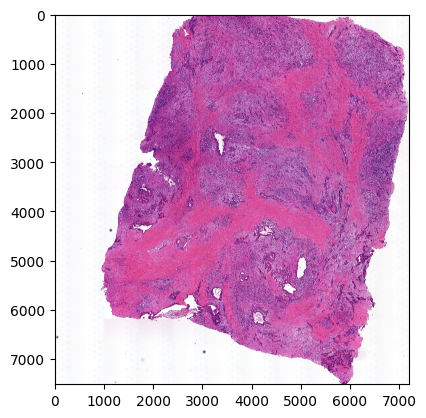

In [57]:
plt.imshow(he)

In [58]:
# context_he = a.uns['rescaled_he']['8X_notrim']
context_he = a.uns['rescaled_he']['8X_trimmed']
context_he.shape

(1878, 1800, 3)

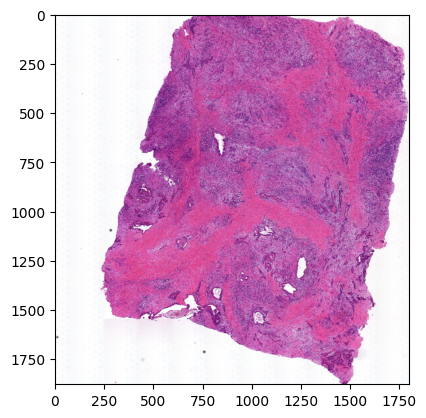

In [59]:
plt.imshow(context_he)

In [60]:
def reflection_mosiac(x, border=256):
    max_r, max_c = x.shape[-2], x.shape[-1]
    if len(x.shape) == 3:
        mosaic = torch.zeros((x.shape[0], max_r + (border * 2), max_c + (border * 2))).to(x.dtype)
    else:
        mosaic = torch.zeros((max_r + (border * 2), max_c + (border * 2))).to(x.dtype)
    
    # make tiles
    top_left = TF.pad(x, padding=[border, border, 0, 0], padding_mode='reflect')
    top_right = TF.pad(x, padding=[0, border, border, 0], padding_mode='reflect')
    bottom_left = TF.pad(x, padding=[border, 0, 0, border], padding_mode='reflect')
    bottom_right = TF.pad(x, padding=[0, 0, border, border], padding_mode='reflect')
    
    if len(x.shape) == 3:
        mosaic[:, :max_r + border, :max_c + border] = top_left
        mosaic[:, :max_r + border, border:] = top_right
        mosaic[:, border:, :max_c + border] = bottom_left
        mosaic[:, border:, border:] = bottom_right
    else:
        mosaic[:max_r + border, :max_c + border] = top_left
        mosaic[:max_r + border, border:] = top_right
        mosaic[border:, :max_c + border] = bottom_left
        mosaic[border:, border:] = bottom_right
    
    return mosaic

In [61]:
def tile_img(img, context_img, context_scale, tile_size=256, window_scale=2):
    context_img = reflection_mosiac(context_img, border=tile_size)
    
    n_rows = (img.shape[1] // tile_size) * window_scale + 1
    n_cols = (img.shape[2] // tile_size) * window_scale + 1
    
    tiles = torch.ones(n_rows * n_cols, img.shape[0], tile_size, tile_size, dtype=img.dtype)
    expanded = torch.ones(img.shape[0],
                          n_rows * tile_size // window_scale + tile_size,
                          n_cols * tile_size // window_scale + tile_size,
                          dtype=img.dtype)
    expanded[:, :img.shape[1], :img.shape[2]] = img
    
    context_tiles = torch.ones(n_rows * n_cols, img.shape[0], tile_size, tile_size, dtype=context_img.dtype)
    
    idx = 0
    top_left = []
    for r in range(n_rows):
        for c in range(n_cols):
            r1 = r * tile_size // window_scale
            c1 = c * tile_size // window_scale
            r2 = r1 + tile_size
            c2 = c1 + tile_size
            tiles[idx] = expanded[:, r1:r2, c1:c2]
            top_left.append((r, c))
            
            center_r = r1 + (tile_size / 2)
            center_c = c1 + (tile_size / 2)
            center_r = int(center_r / context_scale) 
            center_c = int(center_c / context_scale) 
            r1 = center_r - tile_size // 2 + tile_size
            c1 = center_c - tile_size // 2 + tile_size
            r2 = r1 + tile_size
            c2 = c1 + tile_size
            context_tiles[idx] = context_img[:, r1:r2, c1:c2]
            idx += 1
    return tiles, context_tiles, top_left

def get_tile(r, c, img, context_img, context_scale, tile_size=256, window_scale=2):
    r1 = r * tile_size // window_scale
    c1 = c * tile_size // window_scale
    r2 = r1 + tile_size
    c2 = c1 + tile_size
    tile = img[:, r1:r2, c1:c2]

    center_r = r1 + (tile_size / 2)
    center_c = c1 + (tile_size / 2)
    center_r = int(center_r / context_scale) 
    center_c = int(center_c / context_scale) 
    r1 = center_r - tile_size // 2 + tile_size
    c1 = center_c - tile_size // 2 + tile_size
    r2 = r1 + tile_size
    c2 = c1 + tile_size
    context_tile = context_img[:, r1:r2, c1:c2]
    
    return tile, context_tile

In [62]:
def prepare_img(img):
    if img.shape[0] != 3:
        img = rearrange(img, 'h w c -> c h w')
    if not isinstance(img, torch.Tensor):
        img = torch.tensor(img)
    if not img.dtype == torch.float32:
        img = TF.convert_image_dtype(img, dtype=torch.float32)
    
    return img 

class TiledHEDatasetV2(Dataset):
    def __init__(self, img, context_img, context_scale, normalize=True, tile_size=256, window_scale=2):
        super().__init__()
        
        img = prepare_img(img)
        context_img = prepare_img(context_img)

        self.context_scale = context_scale
        self.tile_size = tile_size
        self.window_scale = window_scale
        
        if normalize:
            self.normalize = Normalize((0.771, 0.651, 0.752), (0.229, 0.288, 0.224)) # from HT397B1-H2 ffpe H&E image
        else:
            self.normalize = nn.Identity()
            
        self.context_img = reflection_mosiac(context_img, border=tile_size)
    
        self.n_rows = (img.shape[1] // tile_size) * window_scale + 2
        self.n_cols = (img.shape[2] // tile_size) * window_scale + 2
        
        self.img = torch.ones(img.shape[0],
                          self.n_rows * tile_size // window_scale + tile_size,
                          self.n_cols * tile_size // window_scale + tile_size,
                          dtype=img.dtype)
        self.img[:, :img.shape[1], :img.shape[2]] = img
        
        self.idx_to_top_left = [(r, c)
                                for r in range(self.n_rows)
                                for c in range(self.n_cols)]
            
    def __len__(self):
        return len(self.idx_to_top_left)

    def __getitem__(self, idx):
        r, c = self.idx_to_top_left[idx]
        
        tile, context_tile = get_tile(r, c, self.img, self.context_img, self.context_scale,
                                     tile_size=self.tile_size, window_scale=self.window_scale)
        return {
            'he': self.normalize(tile),
            'context_he': self.normalize(context_tile),
            'top': r,
            'left': c
        }
    
class TiledHEDataset(Dataset):
    def __init__(self, img, context_img, context_scale, normalize=True, tile_size=256, window_scale=2):
        super().__init__()
        
        img = prepare_img(img)
        context_img = prepare_img(context_img)

        self.img = img
        self.context_img = context_img
        self.context_scale = context_scale
        self.tiles, self.context_tiles, self.idx_to_top_left = tile_img(img, context_img, context_scale,
                                                                        tile_size=tile_size, window_scale=window_scale)
        
        if normalize:
            self.normalize = Normalize((0.771, 0.651, 0.752), (0.229, 0.288, 0.224)) # from HT397B1-H2 ffpe H&E image
        else:
            self.normalize = nn.Identity()
            
    def max_r(self):
        rs, cs = zip(*self.idx_to_top_left)
        return np.max(rs)

    def max_c(self):
        rs, cs = zip(*self.idx_to_top_left)
        return np.max(cs)
        
    def __len__(self):
        return self.tiles.shape[0]

    def __getitem__(self, idx):
        tile, context_tile, (r, c) = self.tiles[idx], self.context_tiles[idx], self.idx_to_top_left[idx]
        return {
            'he': self.normalize(tile),
            'context_he': self.normalize(context_tile),
            'top': r,
            'left': c
        }

In [63]:
def add_tile(tile, new, r, c, max_r, max_c, window_scale=2,):
    ts = tile.shape[0] // window_scale
    normal_offset = ts // 2
    edge_offset = tile.shape[0] // 2
    rc, cc = r * ts + edge_offset, c * ts + edge_offset
    trc, tcc = edge_offset, edge_offset

    r1 = rc - normal_offset
    r2 = rc + normal_offset
    c1 = cc - normal_offset
    c2 = cc + normal_offset
    tr1 = trc - normal_offset
    tr2 = trc + normal_offset
    tc1 = tcc - normal_offset
    tc2 = tcc + normal_offset
    if r == 0:
        r1 = rc - edge_offset
        r2 = rc + normal_offset
        tr1 = trc - edge_offset
        tr2 = trc + normal_offset
    if c == 0:
        c1 = cc - edge_offset
        c2 = cc + normal_offset
        tc1 = tcc - edge_offset
        tc2 = tcc + normal_offset
    if r == max_r:
        r1 = rc - normal_offset
        r2 = rc + edge_offset
        tr1 = trc - normal_offset
        tr2 = trc + edge_offset
    if c == max_c:
        c1 = cc - normal_offset
        c2 = cc + edge_offset
        tc1 = tcc - normal_offset
        tc2 = tcc + edge_offset

    new[r1:r2, c1:c2] = tile[tr1:tr2, tc1:tc2]

def predict_he(img, context_img, context_scale, model,
               batch_size=8, num_workers=10,
               gene_idxs=None, keep=('he', 'exp', 'metagene_activity'),
               window_scale=2, rescale=False, resize=True, crop=True):
    orig_shape = img.shape
    ds = TiledHEDatasetV2(img, context_img, context_scale, window_scale=window_scale)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    
    if gene_idxs is None:
        gene_idxs = np.arange(len(model.autokl.genes))
    
    with torch.no_grad():
        batch = next(iter(dl))
        he, he_context, top, left = batch['he'], batch['context_he'], batch['top'], batch['left']

        if next(iter(model.autokl.parameters())).is_cuda:
            he, he_context = he.cuda(), he_context.cuda()

        result = model.autokl(he, context_he, reduce_to_voxel=False, gene_idxs=gene_idxs)
        item = {k:v[0].detach().cpu()
               for k, v in result.items()
               if k in keep}
#         item['exp'] = item['exp'][:, :, gene_idxs]
        item['he'] = rearrange(item['he'], 'c h w -> h w c')
    max_r, max_c = ds.n_rows, ds.n_cols
    key_to_new = {k:torch.ones(tile.shape[0] * (max_r + 2) // window_scale,
                               tile.shape[1] * (max_c + 2) // window_scale,
                               tile.shape[2],
                               dtype=tile.dtype)
                 for k, tile in item.items()}
    
    model.eval()
    with torch.no_grad():
        for batch_idx, batch in enumerate(dl):
            if batch_idx % 20 == 0:
                print(batch_idx * batch_size)
            he, he_context, top, left = batch['he'], batch['context_he'], batch['top'], batch['left']

            if next(iter(model.autokl.parameters())).is_cuda:
                he, he_context = he.cuda(), he_context.cuda()

            result = model.autokl(he, context_he, reduce_to_voxel=False, gene_idxs=gene_idxs)

            for i in range(result['exp'].shape[0]):
                item = {k:v[i].detach().cpu()
                       for k, v in result.items()
                       if k in keep}
#                 item['exp'] = item['exp'][:, :, gene_idxs]
                item['he'] = rearrange(item['he'], 'c h w -> h w c')
                r, c = top[i], left[i]
                for k in keep:
                    tile = item[k]
                    add_tile(tile, key_to_new[k], r, c, max_r, max_c, window_scale=window_scale)
    
    if resize:
        for k, new in key_to_new.items():
            new = new[:orig_shape[0], :orig_shape[1]]
            key_to_new[k] = new
    
    if rescale:
        for k, new in key_to_new.items():
            if k == 'he':
                new -= new.min()
                new /= new.max()
            else:
                new -= new.amin(dim=(0, 1))
                new /= new.amax(dim=(0, 1))
            key_to_new[k] = new

    return key_to_new


In [64]:
model = model.cuda()

In [65]:
# show_genes = ['EPCAM', 'KRT18', 'IL7R', 'MS4A1', 'PECAM1', 'BGN', 'INS']
# show_genes = ['KRT18', 'IL7R', 'PECAM1', 'BGN']
show_genes = model.autokl.genes
gene_idxs = [i for i, g in enumerate(model.autokl.genes) if g in show_genes]
show_genes = model.autokl.genes[gene_idxs]
key_to_retiled = predict_he(he, context_he, 4, model, gene_idxs=gene_idxs, rescale=True, window_scale=2)

0
160
320
480
640
800
960
1120
1280
1440
1600
1760
1920
2080
2240
2400
2560
2720
2880
3040
3200
3360


In [38]:
he.shape

(7082, 6123, 3)

In [39]:
# for k, img in key_to_retiled.items():
#     key_to_retiled[k] = img[:he.shape[0], :he.shape[1]]

In [40]:
for k, img in key_to_retiled.items():
    print(k, img.shape, img.max(), img.amax(dim=(0, 1)))

he torch.Size([7082, 6123, 3]) tensor(1.) tensor([0.8725, 1.0000, 0.9187])
exp torch.Size([7082, 6123, 12]) tensor(1.) tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])
metagene_activity torch.Size([7082, 6123, 10]) tensor(1.) tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])


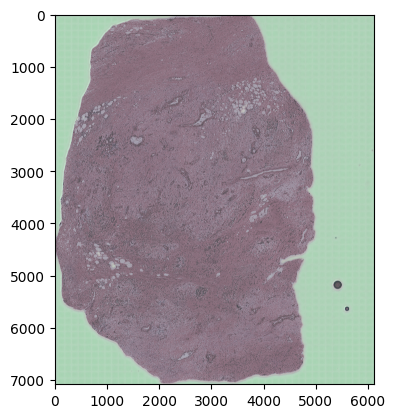

In [41]:
plt.imshow(key_to_retiled['he'])

In [42]:
# plt.imshow(he)

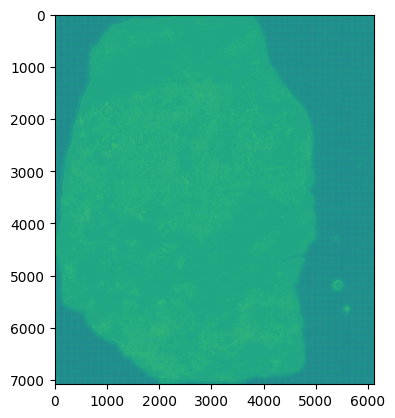

In [43]:
plt.imshow(key_to_retiled['exp'][:, :, 0])

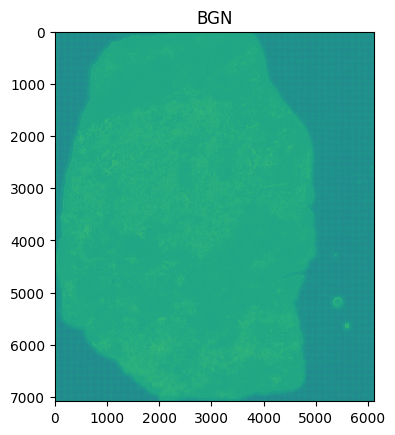

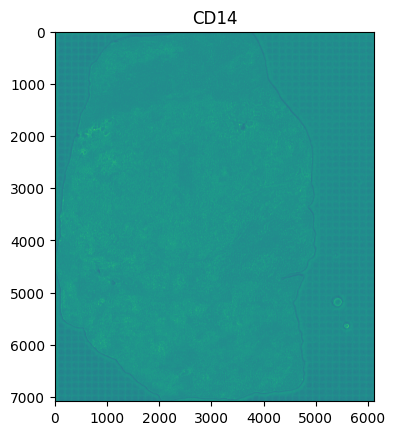

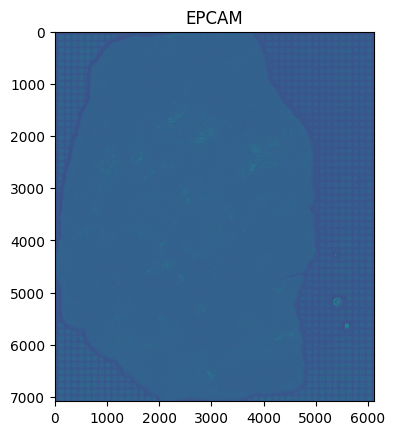

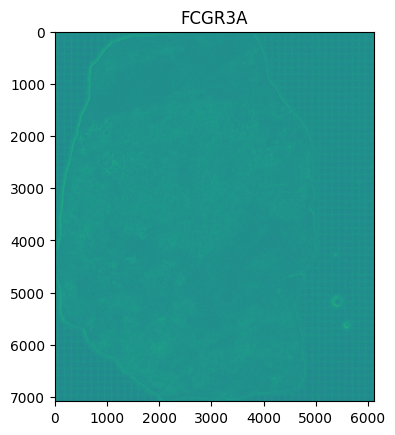

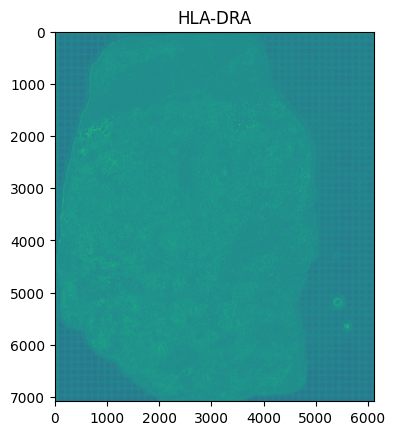

...

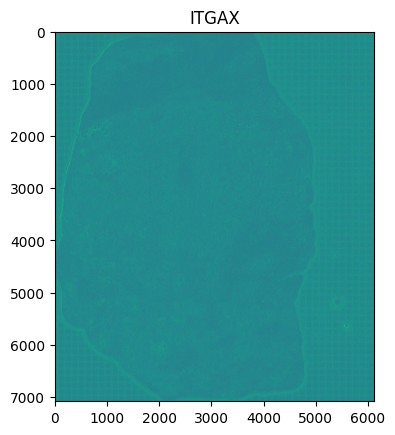

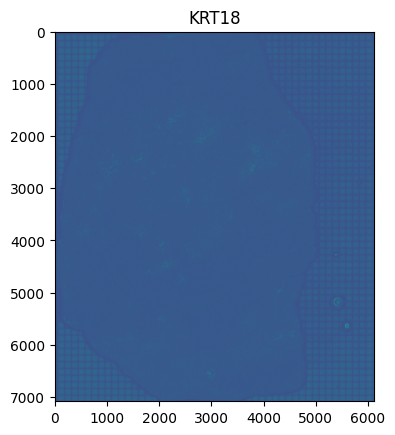

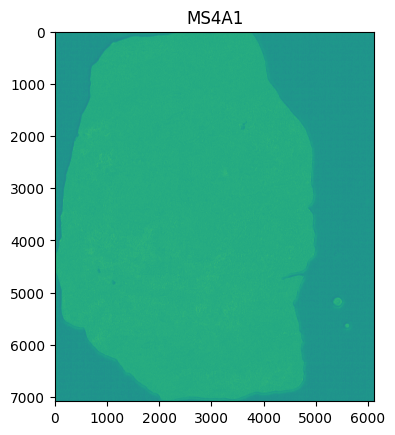

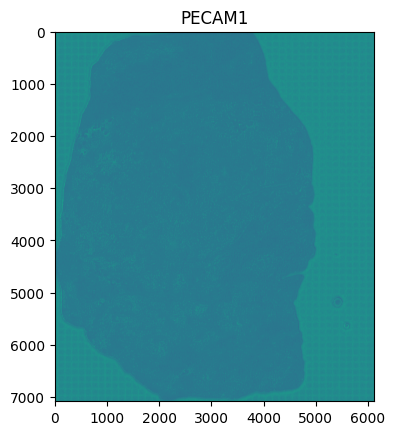

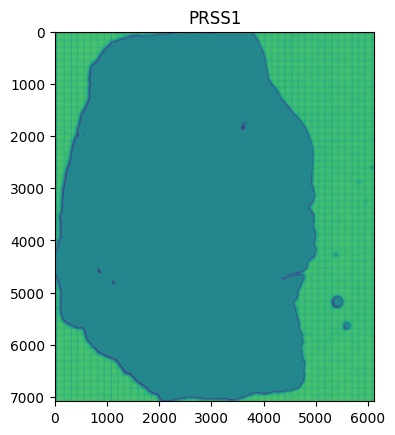

In [44]:
for i, g in enumerate(show_genes):
    plt.imshow(key_to_retiled['exp'][:, :, i])
    plt.title(g)
    plt.show()

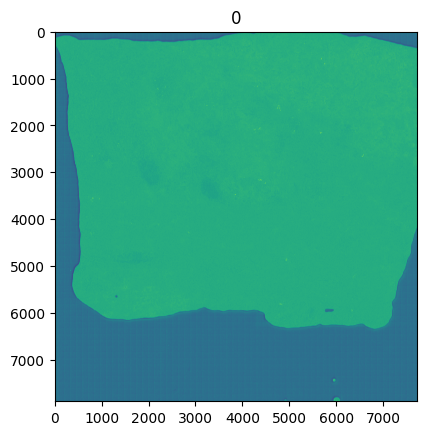

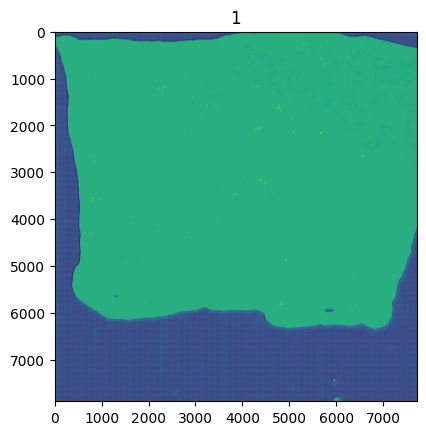

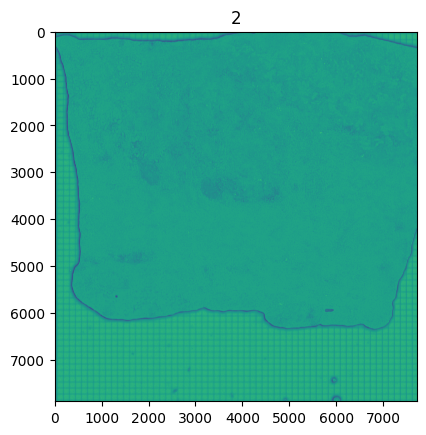

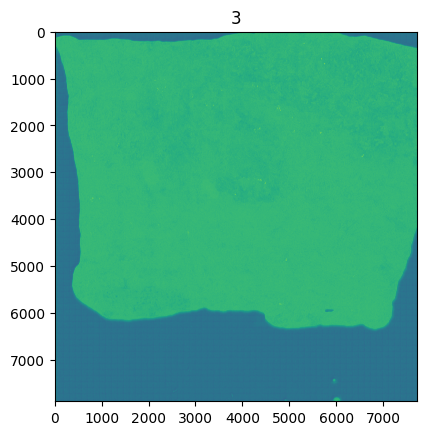

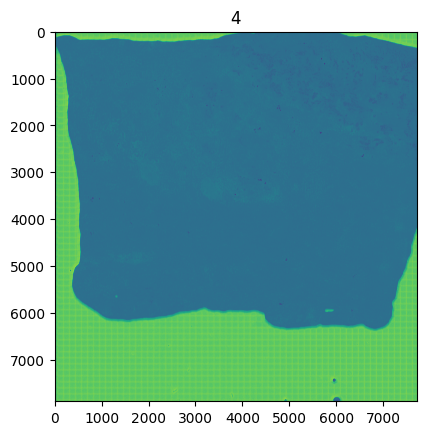

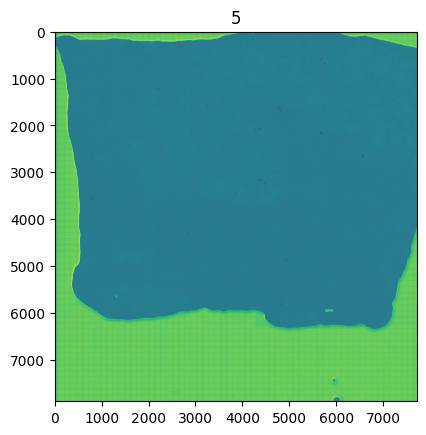

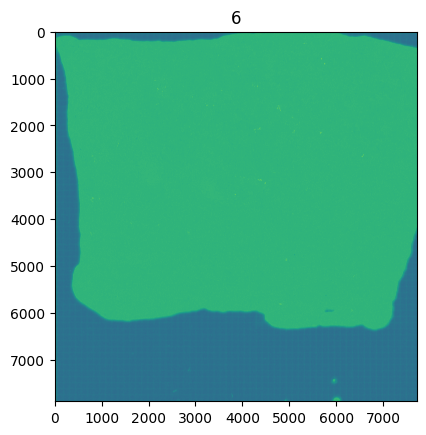

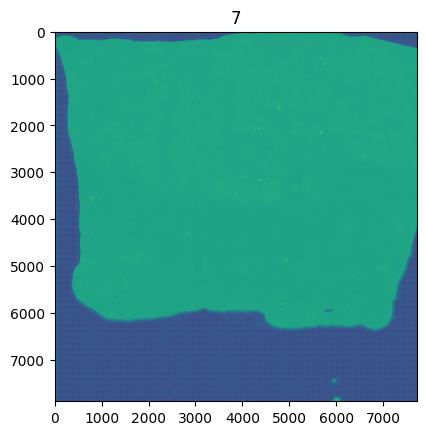

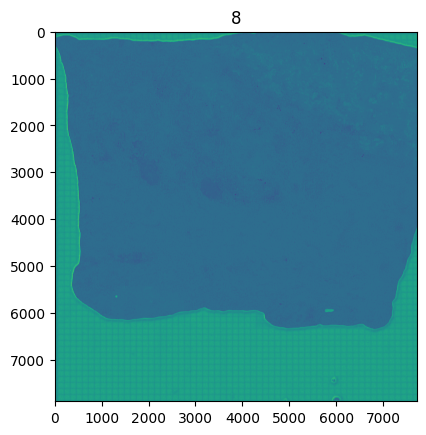

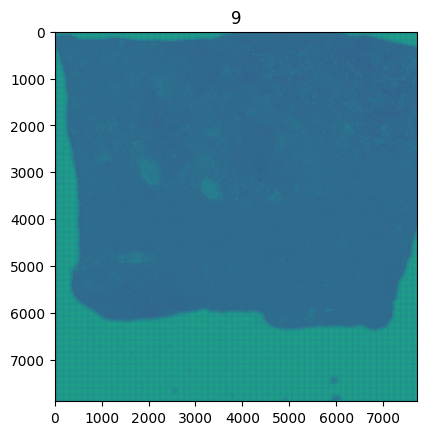

In [83]:
for i in range(key_to_retiled['metagene_activity'].shape[-1]):
    plt.imshow(key_to_retiled['metagene_activity'][:, :, i])
    plt.title(i)
    plt.show()

In [ ]:
# key_to_retiled = predict_he(he, context_he, 4, model, gene_idxs=gene_idxs,
#                             reduce_to_tile=False, batch_size=2, rescale=True, window_scale=2)

In [ ]:
# for i, g in enumerate(show_genes):
#     plt.imshow(np.log1p(key_to_retiled['exp'][:, :, i]))
#     plt.title(g)
#     plt.show()

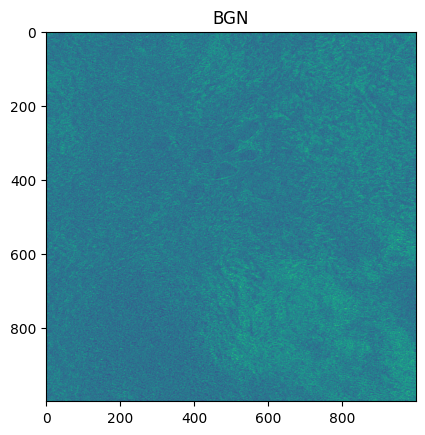

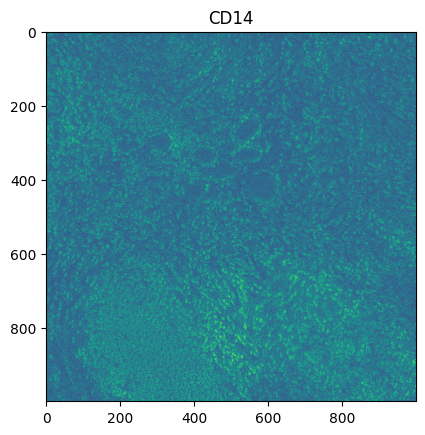

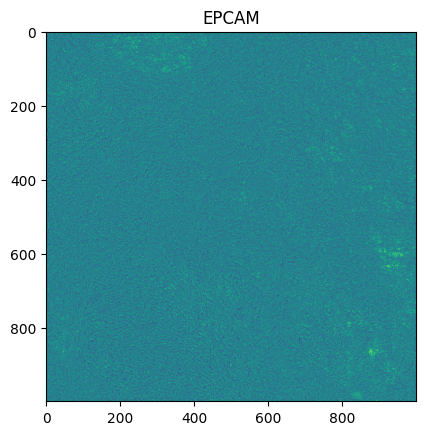

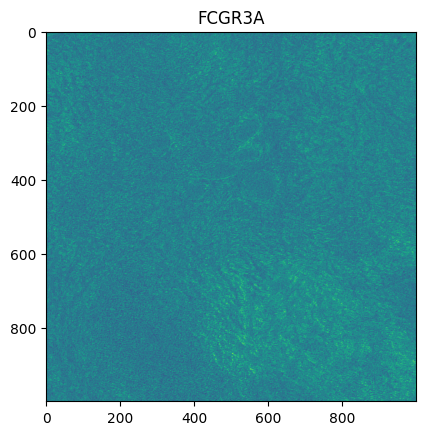

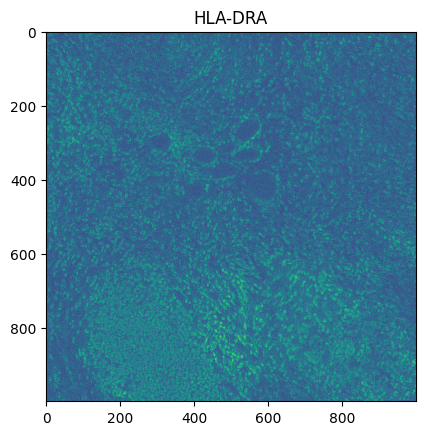

...

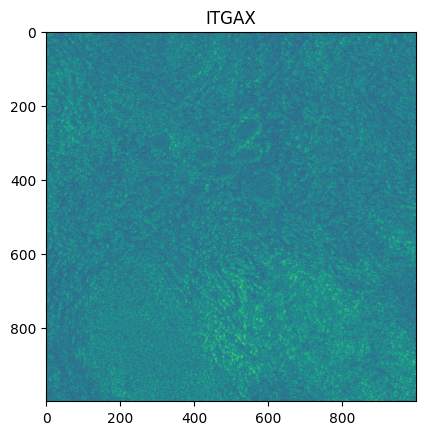

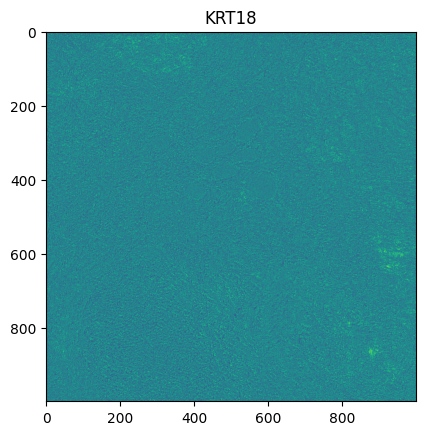

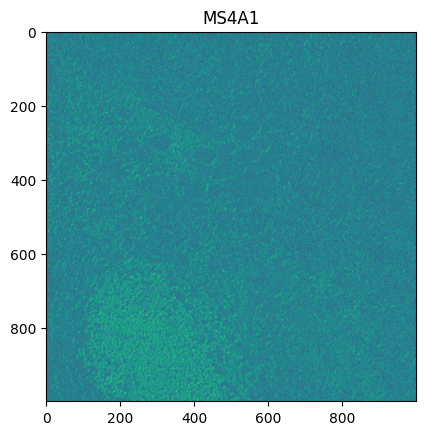

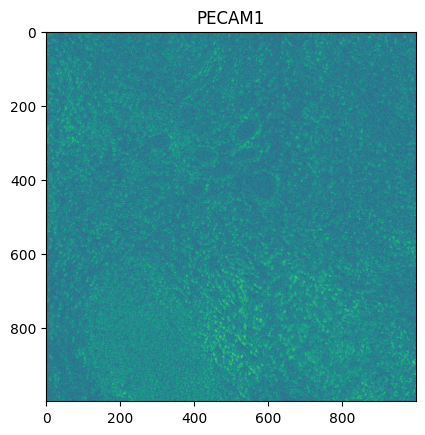

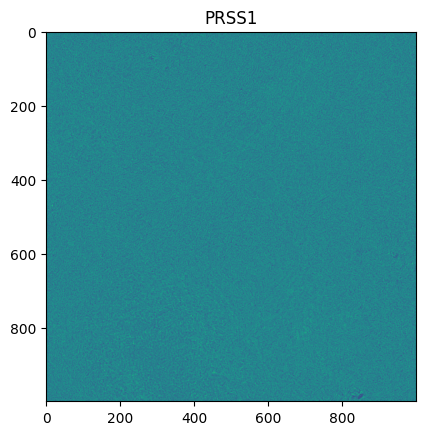

In [84]:
# cr1, cr2 = 3500, 4500
# cc1, cc2 = 4000, 5000
cr1, cr2 = 2500, 3500
cc1, cc2 = 3000, 4000
for i, g in enumerate(show_genes):
    plt.imshow(key_to_retiled['exp'][cr1:cr2, cc1:cc2, i])
    plt.title(g)
    plt.show()

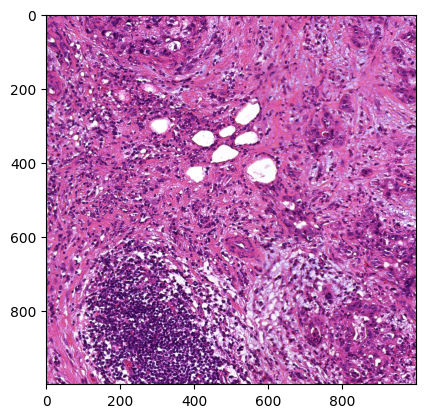

In [85]:
plt.imshow(he[cr1:cr2, cc1:cc2])

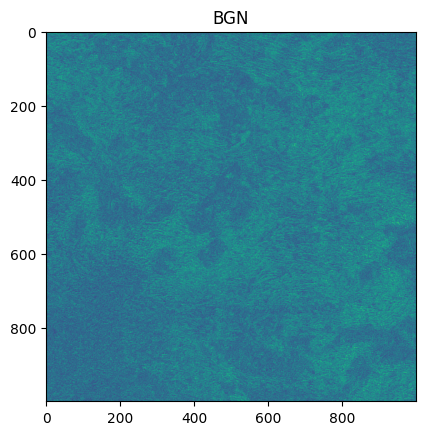

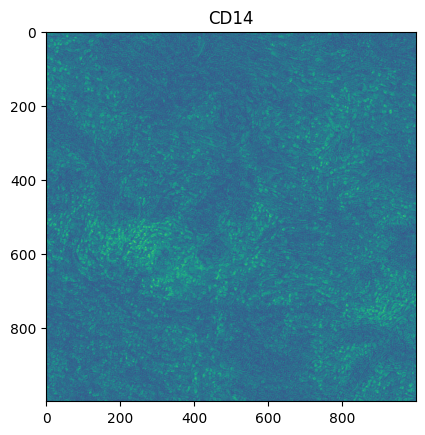

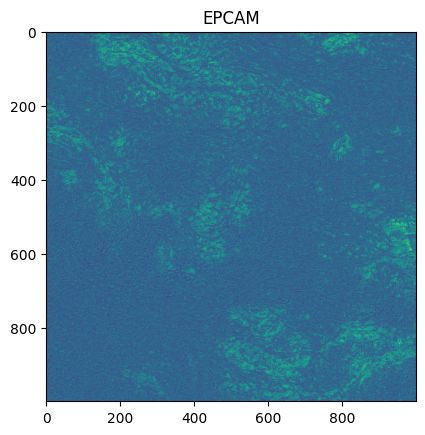

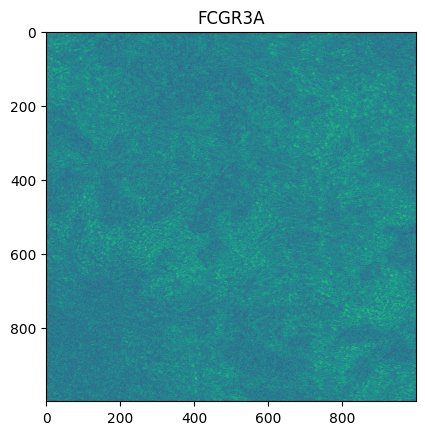

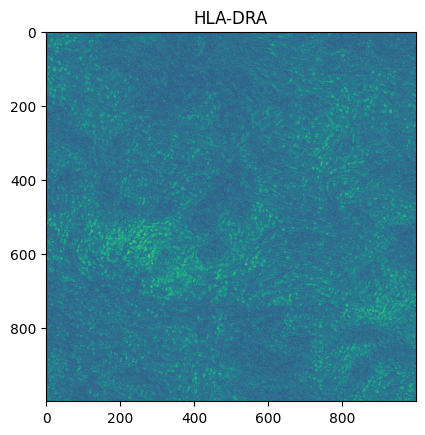

...

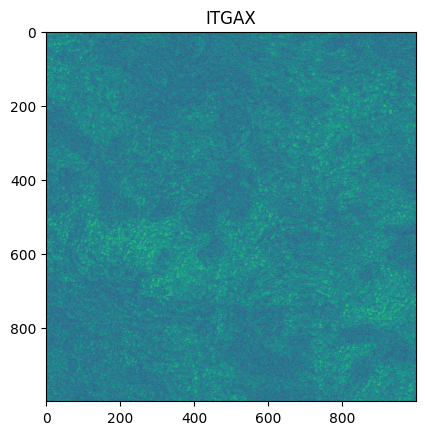

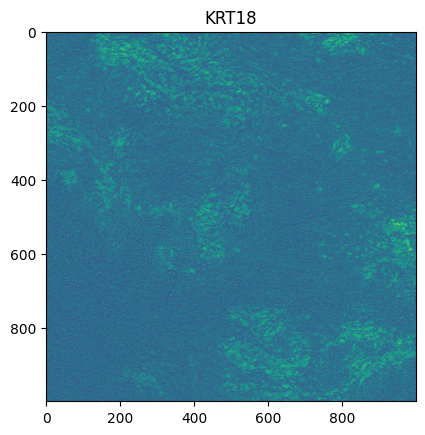

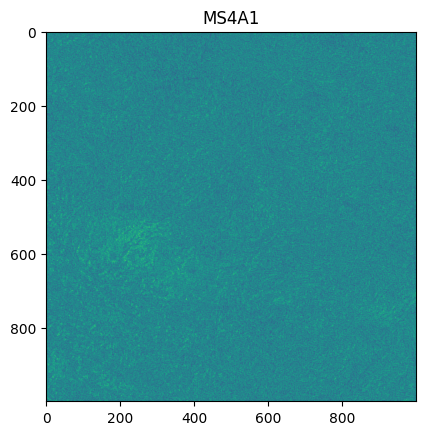

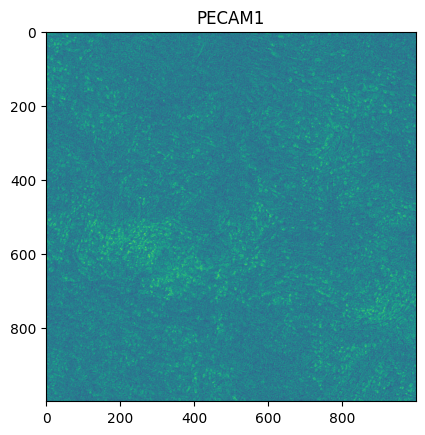

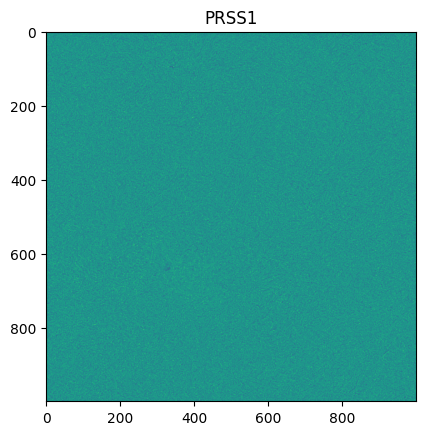

In [88]:
cr1, cr2 = 1500, 2500
cc1, cc2 = 6000, 7000
for i, g in enumerate(show_genes):
    plt.imshow(key_to_retiled['exp'][cr1:cr2, cc1:cc2, i])
    plt.title(g)
    plt.show()

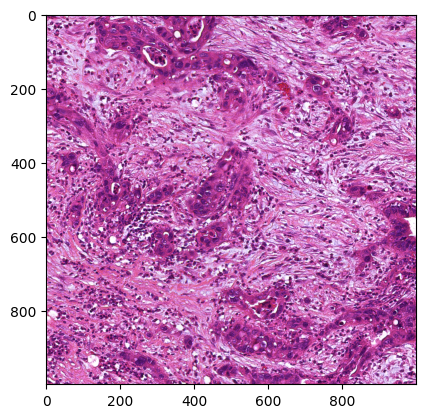

In [89]:
plt.imshow(he[cr1:cr2, cc1:cc2])

In [ ]:
spot_mask = a.uns['rescaled_spot_masks']['2X_trimmed']
spot_mask

In [ ]:
plt.imshow(spot_mask[cr1:cr2, cc1:cc2]>0)

In [ ]:
key_to_retiled['exp'].max()

In [66]:
## save gene expression image
exp = TF.convert_image_dtype(key_to_retiled['exp'], torch.uint8)
exp.shape

torch.Size([7513, 7200, 12])

In [67]:
torch.save(exp, f'../data/annotations/pdac/{s}_exp.pt')

In [68]:
## save gene expression image
meta = TF.convert_image_dtype(key_to_retiled['metagene_activity'], torch.uint8)
meta.shape

torch.Size([7513, 7200, 10])

In [69]:
torch.save(meta, f'../data/annotations/pdac/{s}_meta.pt')

In [70]:
a.uns['2X_trimmed_exp_prediction'] = exp.numpy()
a.uns['2X_trimmed_meta_prediction'] = meta.numpy()
a.uns['genes'] = show_genes
a.write_h5ad(f'../data/annotations/pdac/{s}.h5ad')

In [71]:
s

'HT416P1-S1H1A1U1'

In [ ]:
import seaborn as sns
metagenes = model.autokl.metagenes.detach().cpu().numpy()
metagenes = pd.DataFrame(data=metagenes, columns=model.autokl.genes, index=np.arange(metagenes.shape[0]))
metagenes = metagenes.loc[:, show_genes]
sns.clustermap(data=metagenes)

#### apply directly to H&E